# Between Health and Harm: Topic Modeling of Discussions on Weight Loss and Eating Disorders

**Yilin Xu**  
M.A. in Computational Social Science | University of Chicago  
Email: yilinxu1@uchicago.edu | [LinkedIn](https://www.linkedin.com/in/yilin-xu-367826202/) | [Github](https://github.com/yilinx-10)

### Research Question and Motivation

**Research Question:**  
What are the key themes in discussions around weight loss and eating disorder experiences within online communities? How distinct are the key themes in the two broad categories?  

**Motivation:**  
Reddit offers an open, unfiltered platform where individuals share personal experiences related to weight loss and eating disorders, making it an ideal source of authentic data. Topic modeling can analyze these posts to uncover hidden themes and issues, providing deeper insights into body image, eating behaviors, and mental health. As an unsupervised method, topic modeling doesn't require predefined categories, making it suitable for the complex, overlapping nature of Reddit data. The insights gained can inform moderators, support groups, and mental health professionals by identifying common struggles and strategies, helping design more targeted interventions and resources.

**Literature Review:**

- Chancellor, Stevie, Tanushree Mitra, and Munmun De Choudhury. 2016. “Recovery amid Pro-Anorexia.” Proceedings of the 2016 CHI Conference on Human Factors in Computing Systems, May, 2111–23. doi:10.1145/2858036.2858246.

Chancellor et al. (2016) conducted survival analysis using text processing and manual
annotations on a dataset of “over 10,000 Tumblr users and over 68 million posts.” They used
snowball sampling to obtain 304 tags related to anorexia. The tags were then used to collect posts
in English, which led the researchers to “18,923 unique users.” (Chancellor et al. 2016, 2113)
Among the unique users they have identified, the team only crawls Tumblr history from active
users. The information was used to identify whether the user was in the recovery cohort, signaled
by the absence of posts about relapse and the presence of more than five successive posts
referring to ED recovery. This labeling process is verified by manual annotation. The results
suggest that “81% of the users were correctly identified.” (Chancellor et al. 2016, 2114) This
study used Cox proportional hazards regression model to estimate the time taken to recover based on several measures drawn from psycholinguistic and cognitive behavioral theories and
past literature. They have identified “prospective factors associated with the likelihood of
recovery,” including greater social engagement, lowered self-attentional focus, and increased
positive affect (Chancellor et al. 2016, 2118). However, the study also shows that online social
platforms may act as support and resistance for ED patients because of the large and vocal
presence of anti-recovery groups.

- Wang, Tao, Markus Brede, Antonella Ianni, and Emmanouil Mentzakis. 2017. “Detecting and Characterizing Eating-Disorder Communities on Social Media.” Proceedings of the Tenth ACM International Conference on Web Search and Data Mining, February, 91–100. doi:10.1145/3018661.3018706.

This study examines snowball-sampled online ED communities
in comparison to a randomly selected sample of Twitter users and a random sample of young
female Twitter users. They explore the similarities and differences in terms of social status,
behavioral patterns, and psychometric properties. They also used network analysis to study the
homophily of online ED communities. Validating ED instances were conducted through
calculations of goal and current BMI based on bio-information publicly available on Twitter
profiles.

- Moessner, Markus, Johannes Feldhege, Markus Wolf, and Stephanie Bauer. 2018. “Analyzing Big Data in Social Media: Text and Network Analyses of an Eating Disorder Forum.” International Journal of Eating Disorders 51 (7): 656–67. doi:10.1002/eat.22878.

Moessner et al. (2018) employed computerized content analysis and network analysis to
investigate content posted on the proed forum on Reddit. They have identified that the main topic
is “feedback and social support” for discussions. The result implies that “interacting with peer
and peer support are important reasons to engage in online exchange.” (Moessner et al. 2018,
p.662)

- Branley, D. B., & Covey, J. (2017). Pro-ana versus pro-recovery: A content analytic comparison of social media users’ communication about eating disorders on Twitter and Tumblr. Frontiers in Psychology, 8. doi:10.3389/fpsyg.2017.01356.

Branley and Covey (2017) conducted a content analysis using thematic coding and statistical comparisons on a dataset of "over 12,000 tweets and 73,000 Tumblr posts." They used targeted keyword searches to collect posts in English, identifying three primary content categories: pro-ana, anti-ana, and pro-recovery. A random sample of 709 posts (353 from Twitter, 356 from Tumblr) was analyzed to compare platform differences. The analysis revealed that "pro-ana content was more prevalent on Twitter," whereas "anti-ana and pro-recovery content dominated Tumblr" (Branley and Covey 2017, 5). Users on Twitter were more likely to post ED-related humor, while Tumblr users frequently challenged societal norms around thinness. The study found that "female users contributed the majority of ED-related content," though Twitter had a higher proportion of male users (Branley and Covey 2017, 6). The authors also noted that online communities serve both as a source of support and as a potential risk for vulnerable individuals, emphasizing the need for intervention strategies that balance content moderation with the preservation of positive peer support networks.

**Import Basic Packages:**

In [1]:
import os
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors
import seaborn as sns
from collections import Counter

In [2]:
os.environ["TOKENIZERS_PARALLELISM"] = "false"
warnings.filterwarnings('ignore')

**Data Collection:**  
The data used in this project is downloaded from [Arctic Shift](https://arctic-shift.photon-reddit.com/). Arctic Shift aims at making Reddit data accessible to researchers, moderators and everyone else. It interact with the data through large dumps, an API or web interface. The data downloaded and used for this project are post data from three subreddits: r/loseit, r/EatingDisorders, and r/EDAnonymous from 2024/12/01 to 2025/03/01. We have 26,019 post data in total. Later on, the number decreases as we clean and remove entries that are remove, too short, or duplicated. The data used in topic modeling section has 15,264 entries.

### Data Cleaning & Wrangling

In [3]:
import json
import csv
import pprint

#### Step-by-step Example: loseit Subreddit

In [4]:
posts_lst = []
with open('data/r_loseit_posts.jsonl', 'r') as file:
    for line in file:
        posts_lst.append(json.loads(line))

We should observe the structure of the dictionary to understand what features we want to store in our dataframe and how:

In [5]:
pprint.pprint(posts_lst[0])

{'_meta': {'is_edited': True,
           'removal_type': 'automod_filtered',
           'retrieved_2nd_on': 1733142404,
           'was_deleted_later': True},
 'all_awardings': [],
 'allow_live_comments': False,
 'approved_at_utc': None,
 'approved_by': None,
 'archived': False,
 'author': 'Vanurnin',
 'author_flair_background_color': None,
 'author_flair_css_class': '-kg020',
 'author_flair_richtext': [],
 'author_flair_template_id': 'dcd8342a-c3a5-11e5-9f16-0e30909a2135',
 'author_flair_text': '20kg lost',
 'author_flair_text_color': 'dark',
 'author_flair_type': 'text',
 'author_fullname': 't2_1bcuea',
 'author_is_blocked': False,
 'author_patreon_flair': False,
 'author_premium': False,
 'awarders': [],
 'banned_at_utc': None,
 'banned_by': None,
 'can_gild': False,
 'can_mod_post': False,
 'category': None,
 'clicked': False,
 'content_categories': None,
 'contest_mode': False,
 'created': 1733012795,
 'created_utc': 1733012795,
 'discussion_type': None,
 'distinguished': None,
 '

We define the keys to extract for dataframe:

In [6]:
keys_to_extract = ['permalink', 'subreddit', 'selftext', 'title']

We extract the necessary information and store the data in one large dataframe:

In [7]:
extracted_data = [{k: d[k] for k in keys_to_extract if k in d} for d in posts_lst]
loseit_posts_df = pd.DataFrame(extracted_data)
loseit_posts_df.shape

(14765, 4)

In [8]:
loseit_posts_df[:5]

,permalink,subreddit,selftext,title
0,/r/loseit/comments/1h3qm2g/how_much_protein_ar...,loseit,"So, I'm kinda of a lurker, I don't comment her...",How much protein are you guys eating?
1,/r/loseit/comments/1h3qvw1/not_even_a_big_step...,loseit,[removed],Not even a big step compared to others on here...
2,/r/loseit/comments/1h3qwk3/feeling_too_heavy_f...,loseit,[removed],Feeling too “Heavy” for the gym
3,/r/loseit/comments/1h3qyr5/losing_weight_for_n...,loseit,[removed],Losing weight for new years
4,/r/loseit/comments/1h3r2jt/frustrated/,loseit,[removed],Frustrated


Now that we have loaded the json file and stored the values we need in dataframe, we want to clean our data. To do that, we start by observing the data and gathering information. 

In [9]:
loseit_posts_df.dropna(how = 'any', inplace=True)
loseit_posts_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14765 entries, 0 to 14764
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   permalink  14765 non-null  object
 1   subreddit  14765 non-null  object
 2   selftext   14765 non-null  object
 3   title      14765 non-null  object
dtypes: object(4)
memory usage: 461.5+ KB


We can see that a lot of the text information's dtype is object. We want to convert them to string. Luckily, Pandas has a function that automatically detects the most suitable dtype and convert all values in dataframe to their most suitable dtype.

In [10]:
loseit_posts_df = loseit_posts_df.convert_dtypes()
loseit_posts_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14765 entries, 0 to 14764
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   permalink  14765 non-null  string
 1   subreddit  14765 non-null  string
 2   selftext   14765 non-null  string
 3   title      14765 non-null  string
dtypes: string(4)
memory usage: 461.5 KB


The objects are turned to strings. 

We can also modify the permalink column to complete the fragmented links:

In [11]:
loseit_posts_df['permalink'] = 'https://old.reddit.com' + loseit_posts_df['permalink']

Now, we have a cleaned dataframe ready for analysis. 

In [12]:
loseit_posts_df[:10]

,permalink,subreddit,selftext,title
0,https://old.reddit.com/r/loseit/comments/1h3qm...,loseit,"So, I'm kinda of a lurker, I don't comment her...",How much protein are you guys eating?
1,https://old.reddit.com/r/loseit/comments/1h3qv...,loseit,[removed],Not even a big step compared to others on here...
2,https://old.reddit.com/r/loseit/comments/1h3qw...,loseit,[removed],Feeling too “Heavy” for the gym
3,https://old.reddit.com/r/loseit/comments/1h3qy...,loseit,[removed],Losing weight for new years
4,https://old.reddit.com/r/loseit/comments/1h3r2...,loseit,[removed],Frustrated
5,https://old.reddit.com/r/loseit/comments/1h3r8...,loseit,[removed],how do you count calories at places like mcdon...
6,https://old.reddit.com/r/loseit/comments/1h3rd...,loseit,[removed],Q&A - athletic body
7,https://old.reddit.com/r/loseit/comments/1h3rh...,loseit,[removed],I genuinely don't think i'll ever be satisfied...
8,https://old.reddit.com/r/loseit/comments/1h3rp...,loseit,I’m going through a depressive episode right n...,Any Tips To Stop Eating My Feelings??
9,https://old.reddit.com/r/loseit/comments/1h3rt...,loseit,[removed],70 cal waffles from vans


#### Load Remaining Data with Healper Function

In [13]:
def load_data(FILENAME):
    # Step 1: read json file, store as list of dicts
    posts_lst = []
    with open(FILENAME, 'r') as file:
        for line in file:
            posts_lst.append(json.loads(line))
    # Step 2: Check and set keys of necessary information
    keys_to_extract = ['permalink', 'subreddit', 'selftext', 'title']
    # Step 3: Store Info in Dataframe
    extracted_data = [{k: d[k] for k in keys_to_extract if k in d} for d in posts_lst]
    df = pd.DataFrame(extracted_data)
    # Step 4: Remove rows containing NAs from dataframe 
    df.dropna(how = 'any', inplace=True)
    # Step 5: Convert dtype: object to string
    df = df.convert_dtypes()
    # Step 6: Modifying permalink
    df['permalink'] = 'https://old.reddit.com' + df['permalink']
    return df

In [14]:
ED_posts_df = load_data('data/r_EatingDisorders_posts.jsonl')
EDA_posts_df = load_data('data/r_EDAnonymous_posts.jsonl')

We noticed there are a lot of posts whose selftext is '[removed]'. This means that the posts are either deleted by the redditor themselves or by Reddit. We do not want to include these removed text in our analysis. Hence, we remove them:

In [15]:
loseit_posts_df = loseit_posts_df[loseit_posts_df['selftext'] != '[removed]']
ED_posts_df = ED_posts_df[ED_posts_df['selftext'] != '[removed]']
EDA_posts_df = EDA_posts_df[EDA_posts_df['selftext'] != '[removed]']
data = pd.concat([loseit_posts_df, EDA_posts_df, ED_posts_df], ignore_index = True)

In [16]:
data['subreddit'] = np.where(data['subreddit'] != 'loseit', 'ED', data['subreddit']) 

In [17]:
data

,permalink,subreddit,selftext,title
0,https://old.reddit.com/r/loseit/comments/1h3qm...,loseit,"So, I'm kinda of a lurker, I don't comment her...",How much protein are you guys eating?
1,https://old.reddit.com/r/loseit/comments/1h3rp...,loseit,I’m going through a depressive episode right n...,Any Tips To Stop Eating My Feelings??
2,https://old.reddit.com/r/loseit/comments/1h3rx...,loseit,I've been struggling with binge eating and hav...,Looking for a weight loss buddy!
3,https://old.reddit.com/r/loseit/comments/1h3ry...,loseit,"240+ lbs, 30M, fattest I’ve ever been Working...",Is there a way out for me
4,https://old.reddit.com/r/loseit/comments/1h3s4...,loseit,The past 4 days i've been eating about 1300 to...,Frustrated
...,...,...,...,...
17781,https://old.reddit.com/r/EatingDisorders/comme...,ED,Please delete if not the right sub. How did ...,Struggling to make a drs appointment
17782,https://old.reddit.com/r/EatingDisorders/comme...,ED,i used to have a serious eating disorder i wou...,i haven’t genuinely felt hungry in 3 months.
17783,https://old.reddit.com/r/EatingDisorders/comme...,ED,Hi guys. I’ve decided to go all-in recovery li...,Extreme hunger
17784,https://old.reddit.com/r/EatingDisorders/comme...,ED,"I struggled with Ed since I was 13, I am 22F. ...",Tips/help on Eating Habits


### Exploratory Data Analysis

#### Distribution of Document Size

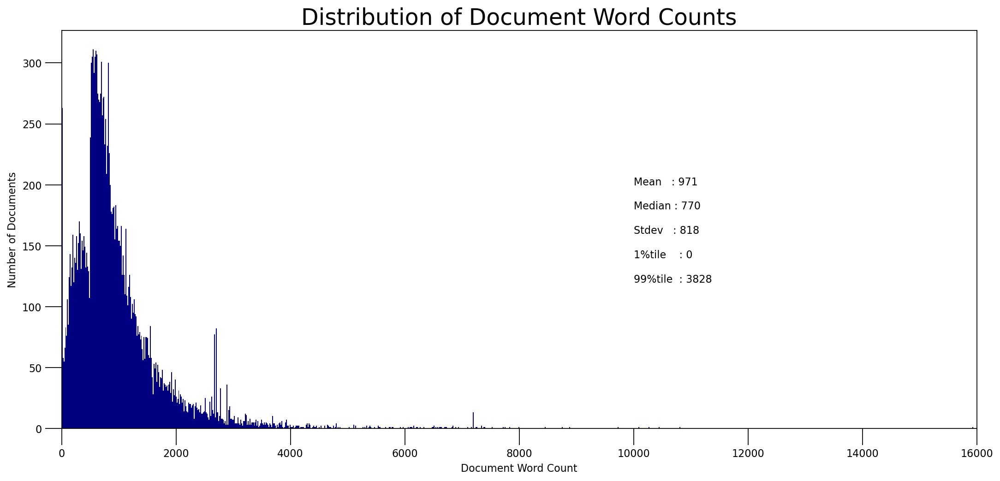

In [18]:
doc_lens = [len(d) for d in data.selftext]

plt.figure(figsize=(16,7), dpi=160)
plt.hist(doc_lens, bins = 1000, color='navy')
plt.text(10000, 200, "Mean   : " + str(round(np.mean(doc_lens))))
plt.text(10000, 180, "Median : " + str(round(np.median(doc_lens))))
plt.text(10000, 160, "Stdev   : " + str(round(np.std(doc_lens))))
plt.text(10000, 140, "1%tile    : " + str(round(np.quantile(doc_lens, q=0.01))))
plt.text(10000, 120, "99%tile  : " + str(round(np.quantile(doc_lens, q=0.99))))

plt.gca().set(xlim=(0, 16000), ylabel='Number of Documents', xlabel='Document Word Count')
plt.tick_params(size=16)
plt.xticks(np.linspace(0,16000,9))
plt.title('Distribution of Document Word Counts', fontdict=dict(size=22))
plt.show()

#### Exploration: Use Logistic Regression to Distinguish between Subreddits

First, we want to understand whether it is plausible to build a classifier to distinguish between posts posted in the three subreddits. We hypothesize that there is some significant different in these posts we can detect using traditional supervised machine learning methods like Count Vectorizer, Tf-Idf Transformer, and Logistic Regression. If the poses in the three subreddits are different in terms of what words or pairs of words are mentioned and how often, we should be able to build a strong model to classify the posts into the subreddits.  

In [19]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.metrics import classification_report
from time import time

In [20]:
data.shape

(17786, 4)

In [21]:
X = data['selftext'] #Our X is text data of the contents of each post
y = data['subreddit']#Our y is the subreddit 

<Axes: xlabel='subreddit', ylabel='Count'>

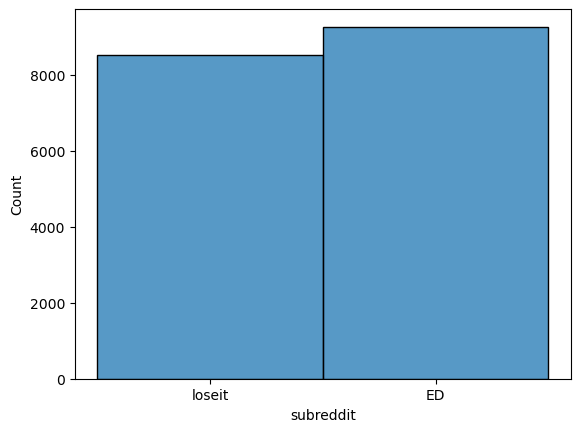

In [22]:
sns.histplot(y)

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42) #Splitting Data for Training and Testing

Notice we shuffle the dataframe as it is composed of all loseit subreddit data followed by all ED subreddits data.

In [24]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((10671,), (7115,), (10671,), (7115,))

We perform a simple GridSearch involving changes in max_df, ngram, normalizaion and penalty to explore the best performing model achievable by tweeking these parameters. 

In [25]:
pipeline = Pipeline(
    [
        ("vect", CountVectorizer()),
        ("tfidf", TfidfTransformer()),
        ("clf", LogisticRegression(max_iter=1000)),
    ]
)

In [26]:
parameters = {
    "vect__max_df": (0.5, 0.75, 1.0),
    "vect__ngram_range": ((1, 1), (1, 2)),  # unigrams or bigrams
    'tfidf__norm': ('l1', 'l2'),
    "clf__penalty": ("l1", "l2"),
}

In [27]:
grid_search = GridSearchCV(pipeline, parameters, n_jobs=-1, verbose=1)

print("Performing grid search...")
print("pipeline:", [name for name, _ in pipeline.steps])
print("parameters:")
pprint.pprint(parameters)
t0 = time()
grid_search.fit(X_train, y_train)
print("done in %0.3fs" % (time() - t0))
print()

print("Best score: %0.3f" % grid_search.best_score_)
print("Best parameters set:")
best_parameters = grid_search.best_estimator_.get_params()
for param_name in sorted(parameters.keys()):
    print("\t%s: %r" % (param_name, best_parameters[param_name]))

Performing grid search...
pipeline: ['vect', 'tfidf', 'clf']
parameters:
{'clf__penalty': ('l1', 'l2'),
 'tfidf__norm': ('l1', 'l2'),
 'vect__max_df': (0.5, 0.75, 1.0),
 'vect__ngram_range': ((1, 1), (1, 2))}
Fitting 5 folds for each of 24 candidates, totalling 120 fits
done in 92.145s

Best score: 0.929
Best parameters set:
	clf__penalty: 'l2'
	tfidf__norm: 'l2'
	vect__max_df: 0.5
	vect__ngram_range: (1, 2)


**Interpretation:**  
min_df = 0.5 for Vectorizer: When building the vocabulary ignore terms that have a document frequency strictly higher than 0.5, creating corpus-specfic stop words.  
clf_penalty is 'l2'. This means Logistic Regression model uses L2 penalty. L2 penalty uses sum of squares of coefficients as penalty term and shrinks coefficients towards but not to zero.  
tfidf_norm is also 'l2'. This means TfidfTransformer model uses sum of squares of vector elements for each output row equal to 1 as normalization.  
ngram is (1, 1), which means only unigrams are considered in the best performing model pipeline for classification.  

In [28]:
y_pred = grid_search.predict(y_test)
print(classification_report(y_pred, y_test))

              precision    recall  f1-score   support

          ED       1.00      1.00      1.00      3723
      loseit       1.00      1.00      1.00      3392

    accuracy                           1.00      7115
   macro avg       1.00      1.00      1.00      7115
weighted avg       1.00      1.00      1.00      7115



**Reflection:**  
Wow! The results are perfect. This means we are facing **overfitting** issue. We can check this by recreate the models using the best parameters given by grid search and check the number of coefficients the logistic regression model has:

In [29]:
count = CountVectorizer(max_df=0.5, ngram_range=(1, 1)).fit_transform(X_train)
tfidf = TfidfTransformer(norm='l2').fit_transform(count)
clf = LogisticRegression(penalty='l2', max_iter=1000).fit(tfidf, y_train)
best_coefs = clf.coef_

In [30]:
len(best_coefs[0])

26790

It turns out that we are using 26,790 features for our model. Each feature is a token that only appears in less than 50% of the documents we input. This means that the present of less frequently used tokens and combinations of presence of these tokens can easily help predict whether the post is posted in the losit subreddit or ED subreddits. This is **bad** modelling. Why? Well, imagine we have one new post that only contains one word, let's say, 'cahbrlgoildfj'. This word does not mean anything. However, by chance, someone's cat stepped on their keyboard and entered the exact same string in a post they were editing. This person did not notice and posted the post in the subreddit. Now, this string/token becomes one of the features in the logistic model we get. The presence of this token results in the hypothetical post we are editing to be strongly classified into the same subreddit the cat-modified post is in. 

Creating a model with so many string features is not optimal. However, our exploration attempt did inform us about some characteristics of the posts data we have. The best performing model from GridSearch uses 0.5 as its max_df. this means that the posts we have **share a lot of common words other than the common terms from the usual English stopwords**(like nltk's stopwords list). We will want to keep this information in mind in future exploration and modelling.

#### Exploration: K-Means Clustering with Posts Text


K-Means Clustering is an unsupervised method for clustering data. Since it is unsupervised, we do not split our data into training, testing, (and validationg) data. 

In [31]:
from collections import defaultdict
from sklearn import metrics
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

In [32]:
category_sizes = [len(loseit_posts_df), len(ED_posts_df) + len(EDA_posts_df)]
category_sizes

[8514, 9272]

In [33]:
evaluations = []
evaluations_std = []
labels = data['subreddit']

def fit_and_evaluate(km, X, name=None, n_runs=5):
    name = km.__class__.__name__ if name is None else name

    train_times = []
    scores = defaultdict(list)
    for seed in range(n_runs):
        km.set_params(random_state=seed)
        t0 = time()
        km.fit(X)
        train_times.append(time() - t0)
        scores["Homogeneity"].append(metrics.homogeneity_score(labels, km.labels_))
        scores["Completeness"].append(metrics.completeness_score(labels, km.labels_))
        scores["V-measure"].append(metrics.v_measure_score(labels, km.labels_))
        scores["Adjusted Rand-Index"].append(
            metrics.adjusted_rand_score(labels, km.labels_)
        )
        scores["Silhouette Coefficient"].append(
            metrics.silhouette_score(X, km.labels_, sample_size=2000)
        )
    train_times = np.asarray(train_times)

    print(f"clustering done in {train_times.mean():.2f} ± {train_times.std():.2f} s ")
    evaluation = {
        "estimator": name,
        "train_time": train_times.mean(),
    }
    evaluation_std = {
        "estimator": name,
        "train_time": train_times.std(),
    }
    for score_name, score_values in scores.items():
        mean_score, std_score = np.mean(score_values), np.std(score_values)
        print(f"{score_name}: {mean_score:.3f} ± {std_score:.3f}")
        evaluation[score_name] = mean_score
        evaluation_std[score_name] = std_score
    evaluations.append(evaluation)
    evaluations_std.append(evaluation_std)

In [34]:
vectorizer = TfidfVectorizer(
    max_df=0.5,
    min_df=0.05,
    stop_words="english",
    lowercase = True
)
t0 = time()
X_tfidf = vectorizer.fit_transform(data['selftext'])

print(f"vectorization done in {time() - t0:.3f} s")
print(f"n_samples: {X_tfidf.shape[0]}, n_features: {X_tfidf.shape[1]}")

vectorization done in 1.586 s
n_samples: 17786, n_features: 220


In [35]:
print(f"{X_tfidf.nnz / np.prod(X_tfidf.shape):.3f}")

0.111


In [36]:
for seed in range(5):
    kmeans = KMeans(
        n_clusters=2,
        max_iter=1000,
        n_init='auto',
        random_state=seed,
    ).fit(X_tfidf)
    cluster_ids, cluster_sizes = np.unique(kmeans.labels_, return_counts=True)
    print(f"Number of elements assigned to each cluster: {cluster_sizes}")
print()
print(
    "True number of documents in each category according to the class labels: "
    f"{category_sizes}"
)

Number of elements assigned to each cluster: [10930  6856]
Number of elements assigned to each cluster: [ 6858 10928]
Number of elements assigned to each cluster: [11484  6302]
Number of elements assigned to each cluster: [ 6875 10911]
Number of elements assigned to each cluster: [10976  6810]

True number of documents in each category according to the class labels: [8514, 9272]


In [37]:
kmeans = KMeans(
    n_clusters=2,
    max_iter=1000,
    n_init='auto',
)

fit_and_evaluate(kmeans, X_tfidf, name="KMeans\non tf-idf vectors")

clustering done in 0.03 ± 0.00 s 
Homogeneity: 0.363 ± 0.016
Completeness: 0.379 ± 0.013
V-measure: 0.371 ± 0.014
Adjusted Rand-Index: 0.437 ± 0.023
Silhouette Coefficient: 0.019 ± 0.001


**Interpretation:**  
We see a consistent(with different seeds) difference between the number of elelments assigned to each cluster and te true number of documents belonging to each cluster(loseit or ED): [10930  6856] vs. [8514, 9272]. We also observe low metrics:Homogeneity: 0.363 ± 0.016, Completeness: 0.379 ± 0.013, V-measure: 0.371 ± 0.014, Adjusted Rand-Index: 0.437 ± 0.023, Silhouette Coefficient: 0.019 ± 0.001. These metrics all suggest that the datas of each type are quite spread out across the two cluster we generate and relatively weak cluster separation. This is consistent with our understanding of the discussion from literature reviews. We expected to observe some overlap between the two subreddits. Posts in loseit, a subreddit for discussions on weight loss, may similar to posts in EatingDisorders and EDAnonymous in terms of what they discuss: weight, height, bmi, food, etc.

**Reflection:**  
After observing the results of K-Means clustering on our text data, we aspire to detect smaller subtopics more aligned with the dicussion of purely weight loss discussions or purely ED-related discussions. For example, posts sharing experience of rehabilitation and recovery after hospitalization for ED, posts discussing episodes of bulimia or anorexia, etc. 

#### Exploration: NLTK Sentiment Analysis with VADER

Next step in our exploration process is generating an emotion profile for our data. NLTK's sentiment analysis with VADER outputs results on alignment with positive or negative emotions and respective scores. 

We comment out the codes used to generate VADER sentiment analysis results because it took a long time to run so we do not want to run it each time we run the notebook. Alternatively, we import from csv file previous VADER sentiment analysis results. 

In [38]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [39]:
# filtered_data = data[data['selftext'].str.len() > 280]
# filtered_data = filtered_data.drop_duplicates(subset=['selftext']).reset_index(drop=True)

In [40]:
# def preprocess_text(text):
#     tokens = word_tokenize(text.lower())
#     filtered_tokens = [token for token in tokens if token not in stopwords.words('english')]
#     lemmatizer = WordNetLemmatizer()
#     lemmatized_tokens = [lemmatizer.lemmatize(token) for token in filtered_tokens]
#     processed_text = ' '.join(lemmatized_tokens)
#     return processed_text

# filtered_data['selftext'] = filtered_data['selftext'].apply(preprocess_text)
# filtered_data

In [41]:
# analyzer = SentimentIntensityAnalyzer()
# def get_sentiment(text):
#     scores = analyzer.polarity_scores(text)
#     sentiment = scores
#     return sentiment['compound']

# filtered_data['sentiment_intensity'] = filtered_data['selftext'].apply(get_sentiment)
# filtered_data[:5]

In [42]:
# filtered_data.to_csv('data/filtered_posts_w_sentiment_analysis.csv', index=False)

In [43]:
vader_results = pd.read_csv('data/filtered_posts_w_sentiment_analysis.csv')

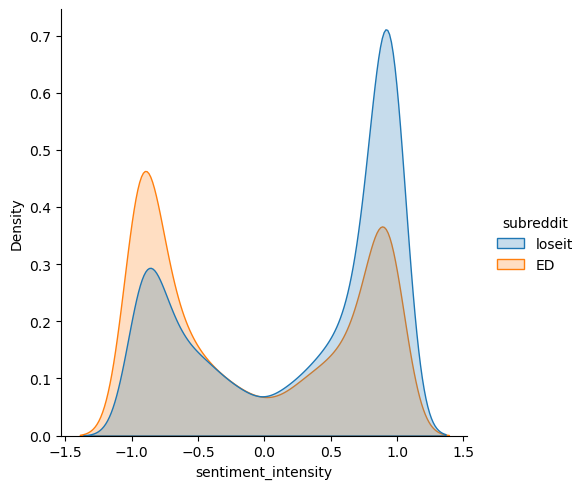

In [44]:
sns.displot(vader_results, 
            x='sentiment_intensity',
            hue='subreddit', 
            kind = 'kde',
            fill = True)

**Interpretation:**  
Observe the graph above, we see the distribution of positive and negative sentiment for the two categories: loseit and ED. We can see that ED(orange), compared to loseit(blue), have higher distirbution of highly negative posts and loseit has higher relative proportion of positive posts. Both categories seem to have polarized distribution of sentiments as we observe s 'valley' centered at 0.0 for sentiment intensity(neutral) for both. 


**Reflection:**  
Emotions are polarized in both cases. It is possible to further explore the specific type of emotions such as anger, disappoitment, etc? We want to test whether specific emotions are correlated to ED discussions. 

#### Hugging Face Sentiment Analysis

Motivation: While VADER provide us with the basic sentiment profile of our data. 'We want to learn more about the specific type of emotions and their corresponding distribution in two categories. To do so, we use the a model by Sam Lowe named "SamLowe/roberta-base-go_emotions." This model outputs 28 emotions and their respective intensity for a text. We also comment out the code used to apply the model and get sentiment scores as the codes took very long to run. We use our saved results from csv file. 

In [45]:
sentiment_lst = ['confusion','approval','realization','neutral','disappointment','disapproval',
                  'curiosity','nervousness','joy','annoyance','optimism','admiration','love',
                  'excitement','sadness','gratitude','fear','surprise','remorse','caring',
                  'relief','embarrassment','desire','anger','disgust','amusement','pride','grief']

In [46]:
# from transformers import pipeline
# classifier = pipeline(task="text-classification", model="SamLowe/roberta-base-go_emotions", top_k=None)

In [47]:
# filtered_data = data[data['selftext'].str.len() > 280]
# filtered_data = filtered_data.drop_duplicates(subset=['selftext']).reset_index(drop=True)

In [48]:
# multi_results = []
# for t in text:
#     multi_results.append(classifier(t[:512]))

In [49]:
# for index, entry in enumerate(multi_results):
#     for i in range(28):
#         filtered_data.loc[index, [entry[0][i]['label']]] = entry[0][i]['score']

In [50]:
# filtered_data.to_csv('data/filtered_posts_w_multisentiment_analysis.csv', index=False)

In [51]:
multi_results = pd.read_csv('data/filtered_posts_w_multisentiment_analysis.csv')

In [52]:
multi_results['subreddit'] = np.where(multi_results['subreddit'] != 'loseit', 'ED', multi_results['subreddit']) 

To explore the results of the multi-sentiment analysis model, we first conduct a Logistic Regression to check whether the 28 scores can predict category the post belongs to:

In [53]:
X = multi_results[sentiment_lst]
y = multi_results['subreddit']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,
                                                    random_state=888)

In [54]:
clf = LogisticRegression(penalty='l2', random_state=888, max_iter = 1000).fit(X_train, y_train)

In [55]:
y_pred = clf.predict(X_test)

In [56]:
print(classification_report(y_test, y_pred, zero_division=np.nan))

              precision    recall  f1-score   support

          ED       0.47      0.11      0.18      2857
      loseit       0.53      0.89      0.67      3249

    accuracy                           0.53      6106
   macro avg       0.50      0.50      0.42      6106
weighted avg       0.50      0.53      0.44      6106



We can see that the results indicate the 28 scores perform worse than random at predicting whether the post belongs to th loseit or ED category. This suggests that the multisentiment profile of our data does not have significant difference in patterns for loseit or ED. We can check this finding by plotting 28 kde plots:

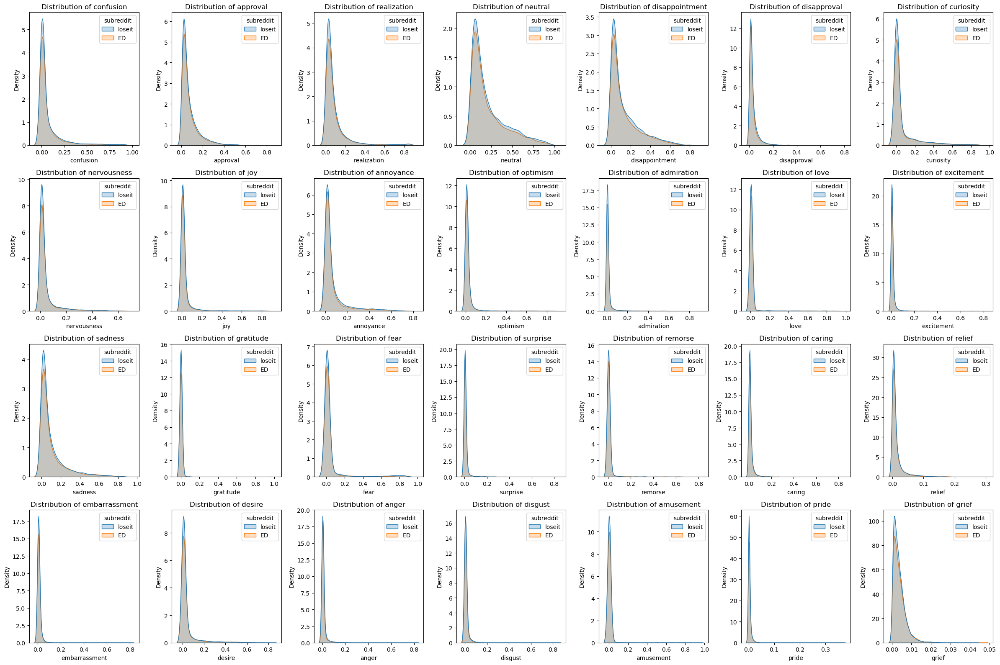

In [57]:
fig, axes = plt.subplots(4, 7, figsize=(24, 16))
axes = axes.flatten()

for i, sentiment in enumerate(sentiment_lst):
    sns.kdeplot(multi_results, 
            x=sentiment,
            hue='subreddit', 
            fill=True,
            ax=axes[i]);
    axes[i].set_title(f'Distribution of {sentiment}')

plt.tight_layout()
plt.show()

**Interpretation:**  
We observe similar distribution of scores for all 28 sentiments between loseit or ED subreddits. In addition, the sentiments with a less extreme distribution are mostly negative sentiments such as grief, sadness, disappointment, etc. and neutral. However, we must note that for each text, we have 28 scores corresponding to the 28 sentiments. Hence, a text may have low score on 27 sentiments and extremely high score on one sentiment. The extremely high score may be hard to notice as the distribution of all scores on the whoe dataset for all sentiments, in this case, will be skewed to the right. 

**Reflection:**  
It seems that multisentiment model tells us the posts in our data are generally negative. The result is different from what we observe from the VADER model. This could be because this model is not good at detecting positive sentiments. Or, it could bethat VADER results contains false positives for positive emotion.

### Modeling and Analysis

We will do topic detection using two unsupervised machine learning methods: LDA and BERTopic, and compare their performances. 

During the topic modeling process, we discovered there are duplicates of text data which seems to be advertisements. We decide to use .unique() and drop_duplicates() to make sure all text data we use are unique. We did not remove all duplicated text data because of two reasons: 1. we are not sure whether there might be advertisements that appear only once in our dataset; 2. we want to include all information a visiter to the included subreddits might consume, which also includes advertisements posted inside the subreddit. 

#### **Traditional Probabilistic Topic Modeling with Gensim LDA**

In [58]:
import gensim
import gensim.corpora as corpora
from gensim.corpora import Dictionary
from gensim.models.coherencemodel import CoherenceModel
from gensim.models.ldamodel import LdaModel
from gensim.parsing.preprocessing import preprocess_documents, strip_tags, strip_punctuation, strip_multiple_whitespaces, strip_numeric, strip_short

import pyLDAvis
import pyLDAvis.gensim

import contractions
import spacy
from gensim.models.phrases import Phrases, ENGLISH_CONNECTOR_WORDS

##### Drop short, repeated entries

We also drop entries shorter than 280 characters as they contain limited information which might negatively impact our topic modeling result.

In [59]:
text = data[data['selftext'].str.len() > 280].selftext.values.unique().tolist()

In [60]:
len(text)

15264

We are working with a dataset of 15,264 text data.

In [61]:
text = [contractions.fix(t) for t in text] # fix issues with I'm, I'll, You've, etc. by expanding them
text = [strip_tags(t) for t in text] # strip tags(#) from text
text = [strip_numeric(t) for t in text] # strip numerical values from text
text = [strip_punctuation(t) for t in text] # strip punctuations from text, may not work for unicode
text = [strip_multiple_whitespaces(t) for t in text] # remove extra whitespaces from text
text = [strip_short(t, minsize=2) for t in text] # remove token shorter than 2 characters from text

The functions above does the basic text preprocessing steps as described by comments.

Now, we face on crucial question. **Which technique should we use to reduce tokens to basic forms? Stemming, or Lemmatization?**

##### Stemming or Lemmatization

We do not really know the answer before we try each method. So, we should prepare our text data for both methods. 

We use the preprocess_documents() function from Gensim package to perform stemming on our text. We save the stemmed text as stem_text for clarity

In [62]:
stem_text = preprocess_documents(text)

We load the lemmatizer model commonly used for English text as Reddit is a predominantly English-using platform. 

In [63]:
nlp = spacy.load("en_core_web_sm")
lemmatizer = nlp.get_pipe("lemmatizer")
print(lemmatizer.mode)  # 'rule'

rule


We save tokens that belong to the five categories: noun, adjectives, verb, adverbs, and proper nouns as the discussion of eating disorder and weight loss might include some domain-specific expressions. 

We use the following code to conduct lemmatization of text with spacy package. We comment out the code as it takes a long time to run. 

In [ ]:
# spacy_text = []
# for sent in text:
#     doc = nlp(sent)
#     texts_out = []
#     for token in doc:
#         if token.pos_ in ['NOUN', 'ADJ', 'VERB', 'ADV', 'PROPN']:
#             texts_out.append(token.lemma_.lower())
#     spacy_text.append(texts_out)

For basic lemmatization of unigrams, we use nlp(), the natural language processing for English langauage model to convert the string texts to an object Spacy understands. Then, we use token.pos_ to check if the token belongs to the predefined categories of words. Lastly, we use .lemma_ to lemmatize the word and convert it to lowercase using lower(). The output is a list of list of strings. 

In [65]:
# with open('data/spacy_text.csv', 'w') as file:
#     write = csv.writer(file)
#     write.writerows(spacy_text)

In [66]:
with open('data/spacy_text.csv') as file:
    reader = csv.reader(file)
    spacy_text = list(reader)

##### Remove Stopwords

Next, we remove the stopwords from our text. We import nltk's stopwords for English and extend it by words indicating time of the day, time of the week, and time of the year as well as words related to the platform such as 'reddit', 'subreddit', 'redditor', etc. because by observing some entries, we believe these words occur in our data with relatively high frequency but does not contribute to main discussion.

In [67]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/elainexu/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [68]:
stop_words = stopwords.words('english')

In [69]:
stop_words.extend(['week', 'day', 'month', 'hour', 'year', 'time', 'reddit', 'thread',
                   'subreddit', 'post', 'morning', 'afternoon', 'evening', 'account',
                   'redditor', 'sort', 'titl', 'share', 'search', 'http', 'www', 'new', 'https'
                   'author', 'com', 'monday', 'tuesday', 'wednesday', 'thursday', 'friday',
                   'saturday', 'sunday', 'mondai', 'tuesdai', 'wednesdai', 'thursdai', 'fridai',
                   'saturdai', 'sundai', 'tomorrow', 'todai', 'today', 'dinner', 'lunch', 'meal', 
                   'breakfast', 'january', 'february', 'march', 'april', 'may', 'june', 'july', 
                   'august', 'september', 'october', 'november', 'december', 'weight', 'eat',
                   'feel', 'like'])

In [70]:
stem_text = [[word for word in doc if word not in stop_words] for doc in stem_text]

In [71]:
spacy_text = [[word for word in doc if word not in stop_words] for doc in spacy_text]

##### Unigram or Bigram

Now, we face another question. **Do we want to use unigram or bigram?**

Similarly, we want to explore the effects before deiciding which method to use, hence, we prepare the lemmatized text data to generate bigrams that appear at least 5 times in all texts, with score above 1, and include common English articles, prepositions and conjuctions. 

The code uses the Phraser model from Gensim. It defines all phrases using the Phrases object definition we provide and store as object 'bigram'. 

In [72]:
bigram = Phrases(spacy_text, min_count=5, threshold=1, connector_words=ENGLISH_CONNECTOR_WORDS)
bigram_mod = gensim.models.phrases.Phraser(bigram)
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

The score(threshold) of 1 is calculated using the following function: (bigram_count - min_count) * len_vocab / (worda_count * wordbcount)

In [73]:
bigram_text = make_bigrams(spacy_text)

##### Compute Dictionaries and Corpus

We define the following helper function to compute the corresponding dictionaries and corpuses for each text. 

In [74]:
def compute_dict_corpus(text):
    id2word = Dictionary(text)
    corpus = [id2word.doc2bow(t) for t in text]
    return id2word, corpus

In [75]:
stem_id2word, stem_corpus = compute_dict_corpus(stem_text)
spacy_id2word, spacy_corpus = compute_dict_corpus(spacy_text)
bigram_id2word, bigram_corpus = compute_dict_corpus(bigram_text)

To check the results, we use itertools to print our the concetenated tokens of first text

In [76]:
import itertools

In [77]:
' '.join(list(itertools.chain(*stem_text[:1])))

'kind lurker comment assidu reader start journei lost kg start think gain muscl mass kind confus daili protein goal gui state kind common protein know possibl consum dai chicken breast protein half kilo chicken breast everydai want cheap protein sourc live world countri absurd bean protein miss think take whei protein advic light thank'

In [78]:
' '.join(list(itertools.chain(*spacy_text[:1])))

'kind lurker comment much assiduous reader start journey lose kg start think gain muscle mass say kind confused daily protein goal guy state kind common say protein even know possible consume chicken breast protein half kilo chicken breast everyday want cheap protein source live rd world country even absurd bean protein miss think take protein give advice light thank'

In [79]:
' '.join(list(itertools.chain(*bigram_text[:1])))

'kind lurker comment much assiduous reader start_journey lose_kg start think gain_muscle mass say kind_confused daily protein_goal guy state kind common say protein even_know possible consume chicken_breast protein half kilo chicken_breast everyday want cheap protein_source live rd world country_even absurd bean protein miss think take protein give_advice light thank'

Observing the differences between above words for first post, we can see successful construction of some bigrams like protein_goal which by intuition should be highly correlated to non-ED discussions. 

##### Basic LDA Implementation

Now that we have prepared our tex, corpus and dictionary, we can start experimenting with the LDA model. We first define two helper functions which outputs information about LDA Model necessary for evaluation and tuning later on.

In [80]:
def compute_coherence_values(corpus, dictionary, k, text):
    '''
    Construct LDA Model and compute overall and per topic coherence score
    '''
    model = LdaModel(corpus=corpus,
                   id2word=dictionary,
                   num_topics=k,
                   chunksize=100,
                   alpha='auto',
                   per_word_topics=True,
                   random_state = 888)
    
    coherence_model_lda = CoherenceModel(model=model, texts=text, dictionary=dictionary, coherence='c_v')
    
    return model, coherence_model_lda.get_coherence(), coherence_model_lda.get_coherence_per_topic()

def implement_lda(corpus, id2word, t, num_topics):
    '''
    Print information for LDA model
    '''
    lda_model, coherence_lda, topic_coherence_lda = compute_coherence_values(corpus, id2word, num_topics, t)

    pprint.pprint(lda_model.print_topics())
    print('Coherence Score: ', coherence_lda)
    print('Topic Coherence Score: ', topic_coherence_lda)

    return lda_model

We start by checking the LDA model for all thee forms of text(stemming, lemmatization, lemmatization + bigram) for 10 topics. 

In [81]:
stem_lda_model = implement_lda(stem_corpus, stem_id2word, stem_text, 10)

[(0,
  '0.063*"dai" + 0.021*"calori" + 0.018*"advic" + 0.018*"trigger" + '
  '0.017*"try" + 0.012*"exercis" + 0.012*"start" + 0.010*"diet" + 0.010*"work" '
  '+ 0.009*"know"'),
 (1,
  '0.087*"wish" + 0.028*"cook" + 0.026*"respons" + 0.024*"chicken" + '
  '0.024*"chees" + 0.023*"countri" + 0.022*"egg" + 0.021*"rice" + '
  '0.020*"protein" + 0.020*"known"'),
 (2,
  '0.097*"answer" + 0.056*"tonight" + 0.049*"receiv" + 0.027*"awkward" + '
  '0.025*"red" + 0.019*"recip" + 0.011*"pale" + 0.011*"unit" + 0.011*"dollar" '
  '+ 0.009*"america"'),
 (3,
  '0.048*"spend" + 0.030*"list" + 0.028*"sent" + 0.026*"women" + '
  '0.023*"student" + 0.021*"pasta" + 0.021*"chest" + 0.020*"shower" + '
  '0.020*"servic" + 0.018*"grate"'),
 (4,
  '0.096*"food" + 0.038*"bing" + 0.027*"restrict" + 0.021*"stop" + '
  '0.020*"scare" + 0.016*"hungri" + 0.015*"control" + 0.011*"treatment" + '
  '0.011*"thing" + 0.010*"snack"'),
 (5,
  '0.101*"support" + 0.090*"diagnos" + 0.051*"mention" + 0.047*"open" + '
  '0.045*"s

In [82]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(stem_lda_model, stem_corpus, stem_id2word)
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
6      0.282693 -0.006630       1        1  35.584017
0      0.230513 -0.044399       2        1  21.621001
9      0.256265 -0.017301       3        1  18.424616
4      0.208688  0.017361       4        1  12.007472
8      0.122706  0.057439       5        1   6.427801
1     -0.223159 -0.094091       6        1   1.658818
5     -0.203100 -0.157724       7        1   1.473857
7     -0.204724  0.354782       8        1   1.374807
3     -0.227780 -0.071392       9        1   1.206690
2     -0.242103 -0.038045      10        1   0.220923, topic_info=              Term          Freq         Total Category  logprob  loglift
59            food  12767.000000  12767.000000  Default  30.0000  30.0000
12             dai  14682.000000  14682.000000  Default  29.0000  29.0000
329       recoveri   3162.000000   3162.000000  Default  28.0000  28.0000
98            bing   4852.000000   4852.000000  Default  27.0000  27.0000
631           help   8140.000000   8140.000000  Default  26.0000  26.0000
...            ...           ...           ...      ...      ...      ...
574         loseit      0.336696      1.372413  Topic10  -8.8037   4.7100
570          graph      0.318980      1.351750  Topic10  -8.8577   4.6711
5931  afdmhaoaaiat      0.305011      1.485094  Topic10  -8.9025   4.5322
5937           usf      0.305011      1.485094  Topic10  -8.9025   4.5322
514       question      1.438312   1171.900802  Topic10  -7.3516  -0.5878

[543 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
487       1  0.266614      abl
487       2  0.143887      abl
487       3  0.539768      abl
487       4  0.031932      abl
487       5  0.017313      abl
...     ...       ...      ...
1947      4  0.027354    write
1947      5  0.964217    write
705       6  0.996235   yogurt
681       8  0.997935    young
2918      1  0.998338  younger

[1004 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 1, 10, 5, 9, 2, 6, 8, 4, 3])

In [83]:
spacy_lda_model = implement_lda(spacy_corpus, spacy_id2word, spacy_text, 10)

[(0,
  '0.070*"body" + 0.059*"recovery" + 0.034*"look" + 0.028*"skinny" + '
  '0.024*"fat" + 0.023*"stomach" + 0.012*"pain" + 0.011*"safe" + 0.011*"young" '
  '+ 0.011*"girl"'),
 (1,
  '0.023*"say" + 0.019*"people" + 0.014*"ask" + 0.014*"find" + 0.013*"want" + '
  '0.012*"use" + 0.012*"support" + 0.011*"comment" + 0.011*"make" + '
  '0.010*"call"'),
 (2,
  '0.048*"go" + 0.041*"get" + 0.019*"work" + 0.018*"try" + 0.016*"tell" + '
  '0.013*"want" + 0.012*"hard" + 0.012*"parent" + 0.011*"know" + 0.011*"able"'),
 (3,
  '0.023*"know" + 0.023*"start" + 0.021*"really" + 0.021*"get" + 0.020*"lose" '
  '+ 0.017*"go" + 0.016*"want" + 0.016*"gain" + 0.015*"much" + 0.012*"also"'),
 (4,
  '0.038*"food" + 0.022*"ed" + 0.021*"make" + 0.020*"know" + 0.018*"disorder" '
  '+ 0.017*"want" + 0.016*"bad" + 0.016*"even" + 0.015*"think" + '
  '0.013*"binge"'),
 (5,
  '0.112*"uncomfortable" + 0.043*"background" + 0.028*"yogurt" + '
  '0.026*"version" + 0.022*"intend" + 0.021*"denial" + 0.020*"product" + '
  '

In [84]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(spacy_lda_model, spacy_corpus, spacy_id2word)
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3     -0.249972 -0.024826       1        1  34.577750
4     -0.225505  0.065027       2        1  25.634359
2     -0.219193  0.098268       3        1  13.413617
1     -0.175821 -0.002249       4        1  10.626040
9     -0.162859  0.140884       5        1   6.571150
0     -0.120063 -0.324576       6        1   6.555682
6      0.281895  0.037625       7        1   0.877724
7      0.289623  0.015177       8        1   0.805843
8      0.285866 -0.015083       9        1   0.673157
5      0.296029  0.009752      10        1   0.264677, topic_info=          Term          Freq         Total Category  logprob  loglift
302       body   8625.000000   8625.000000  Default  30.0000  30.0000
348   recovery   4483.000000   4483.000000  Default  29.0000  29.0000
65        food  12009.000000  12009.000000  Default  28.0000  28.0000
69          go  16846.000000  16846.000000  Default  27.0000  27.0000
123       look   7429.000000   7429.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
4294       pun     13.201542     14.206187  Topic10  -5.4401   5.8611
3485    quinoa     12.457637     13.458383  Topic10  -5.4981   5.8571
2955   yoghurt     11.922865     12.920321  Topic10  -5.5420   5.8541
5069   calcium      9.769666     10.767004  Topic10  -5.7411   5.8372
1054        xl      9.621763     10.619155  Topic10  -5.7564   5.8358

[584 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
523       1  0.145461     able
523       2  0.002537     able
523       3  0.701088     able
523       4  0.024948     able
523       5  0.106981     able
...     ...       ...      ...
1054     10  0.941694       xl
2955     10  0.928770  yoghurt
766      10  0.991232   yogurt
740       4  0.036159    young
740       6  0.963031    young

[1178 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 5, 3, 2, 10, 1, 7, 8, 9, 6])

In [85]:
bigram_lda_model = implement_lda(bigram_corpus, bigram_id2word, bigram_text, 10)

[(0,
  '0.058*"guilty" + 0.025*"helpful" + 0.022*"really_struggle" + 0.017*"alot" + '
  '0.016*"psychiatrist" + 0.014*"ik" + 0.014*"panic" + 0.014*"purpose" + '
  '0.013*"lost" + 0.011*"binge_disorder"'),
 (1,
  '0.028*"ed" + 0.021*"get" + 0.020*"know" + 0.018*"start" + 0.014*"think" + '
  '0.011*"recovery" + 0.010*"want" + 0.010*"work" + 0.009*"even" + '
  '0.009*"trigger"'),
 (2,
  '0.021*"want" + 0.019*"say" + 0.018*"know" + 0.016*"tell" + 0.016*"food" + '
  '0.013*"make" + 0.012*"bad" + 0.010*"help" + 0.010*"body" + 0.010*"life"'),
 (3,
  '0.032*"food" + 0.015*"snack" + 0.010*"usually" + 0.010*"drink" + '
  '0.008*"full" + 0.008*"yesterday" + 0.008*"go" + 0.007*"stuff" + '
  '0.007*"make" + 0.007*"upset"'),
 (4,
  '0.034*"address" + 0.029*"want_look" + 0.024*"apologize" + 0.024*"hang" + '
  '0.022*"close_friend" + 0.018*"language" + 0.018*"correct" + '
  '0.013*"reassurance" + 0.012*"direction" + 0.011*"guess_look"'),
 (5,
  '0.018*"lose" + 0.017*"scared" + 0.015*"still" + 0.012*"k

In [86]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(bigram_lda_model, bigram_corpus, bigram_id2word)
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.208177  0.010355       1        1  23.910909
1      0.225207 -0.003208       2        1  22.252223
7      0.222690 -0.000886       3        1  18.316643
5      0.163972 -0.018030       4        1  11.815412
9      0.160675 -0.010219       5        1  10.919194
3      0.085075 -0.007364       6        1   8.744785
8     -0.239845  0.343803       7        1   2.177257
0     -0.273930 -0.172299       8        1   1.434499
6     -0.273615 -0.068003       9        1   0.220597
4     -0.278405 -0.074150      10        1   0.208480, topic_info=              Term         Freq        Total Category  logprob  loglift
314             ed  6008.000000  6008.000000  Default  30.0000  30.0000
57            food  8166.000000  8166.000000  Default  29.0000  29.0000
1401      disorder  4323.000000  4323.000000  Default  28.0000  28.0000
804           look  3717.000000  3717.000000  Default  27.0000  27.0000
581         scared  1925.000000  1925.000000  Default  26.0000  26.0000
...            ...          ...          ...      ...      ...      ...
2094  yesterday_go     6.779879     7.749241  Topic10  -5.6810   6.0394
498       creative     5.869271     6.841034  Topic10  -5.8252   6.0199
7999          cell     5.304098     6.274128  Topic10  -5.9264   6.0051
550      want_join     4.267473     5.238722  Topic10  -6.1439   5.9680
2086  offer_advice     2.912159     3.883873  Topic10  -6.5260   5.8851

[581 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
1234      2  0.998444        actual
294       2  0.010609     addiction
294       6  0.058350     addiction
294       7  0.922999     addiction
3637     10  0.991217       address
...     ...       ...           ...
491       6  0.998391     yesterday
2094     10  0.903314  yesterday_go
199       4  0.933437           yet
199       6  0.065181           yet
849       3  0.998240         young

[1127 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 2, 8, 6, 10, 4, 9, 1, 7, 5])

We shall interpret the basic pyLDAvis visualization further in the next section. 

##### Searching For Ideal Topic Number

We define the following function to try different number of topics used to generate model. 

In [87]:
def evaluate_lda(corpus, dictionary, text):
    '''
    Generate model performance in terms of coherence score
    for number of topics from 2 to 40. 
    '''
    # Topics range
    topics_range = range(2, 41, 1)

    # Dictionary to store results
    model_results = {'Topics': [],
                    'Coherence': [],
                    'Topic Coherence': []
                    }

        # iterate through number of topics
    for k in topics_range:
        # get the coherence score for the given parameters
        _, cv, tcv = compute_coherence_values(corpus, dictionary, k, text) 
        # Save the model results
        model_results['Topics'].append(k)
        model_results['Coherence'].append(cv)
        model_results['Topic Coherence'].append(tcv)
                        
    return model_results

We comment out the following two cells of code to save time.

In [88]:
# stem = evaluate_lda(stem_corpus, stem_id2word, stem_text)
# lem = evaluate_lda(spacy_corpus, spacy_id2word, spacy_text)
# lem_bigram = evaluate_lda(bigram_corpus, bigram_id2word, bigram_text)

In [89]:
# with open('data/lda_stem.json', 'w') as file:
#     json.dump(stem, file)
# with open('data/lda_lem.json', 'w') as file:
#     json.dump(lem, file)
# with open('data/lda_bigram.json', 'w') as file:
#     json.dump(lem_bigram, file)

In [90]:
with open('data/lda_stem.json', 'r') as file:
    stem = json.load(file)
with open('data/lda_lem.json', 'r') as file:
    lem = json.load(file)
with open('data/lda_bigram.json', 'r') as file:
    lem_bigram = json.load(file)

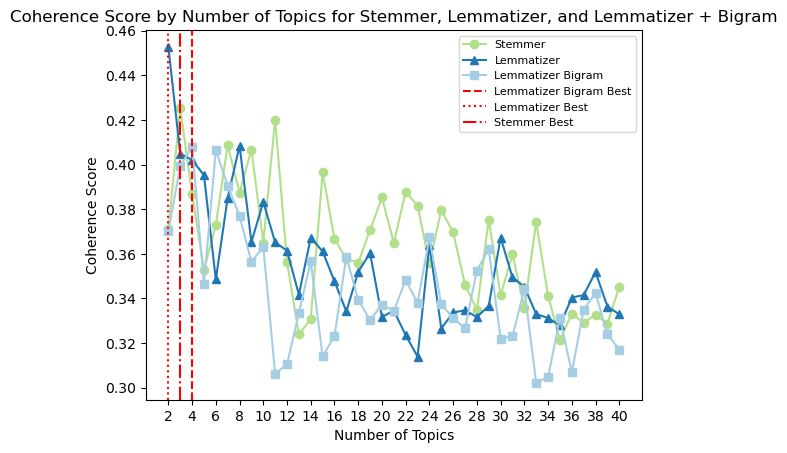

In [91]:
plt.plot(range(2, 41, 1), stem['Coherence'], "o-", label="Stemmer", color = '#b2df8a')
plt.plot(range(2, 41, 1), lem['Coherence'], "^-", label="Lemmatizer", color = '#1f78b4')
plt.plot(range(2, 41, 1), lem_bigram['Coherence'], "s-", label="Lemmatizer Bigram", color = '#a6cee3')
plt.title("Coherence Score by Number of Topics for Stemmer, Lemmatizer, and Lemmatizer + Bigram")
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score")
plt.xticks(range(2, 41, 2))
plt.axvline(x = 4, color = 'r', linestyle="--", label = 'Lemmatizer Bigram Best')
plt.axvline(x = 2, color = 'r', linestyle=":", label = 'Lemmatizer Best')
plt.axvline(x = 3, color = 'r', linestyle="-.", label = 'Stemmer Best')
plt.legend(fontsize=8)
plt.show()

We observe a general trend that the coherence score decrease(with fluctuations as the process of identifying topics are random) as the number of topics increase. This is because as the number of topics we aim to identify with the model increases, **more small topics as well as overlapped topics are formed.** This can be observed in the Basic LDA Implementation above when we set the number of topics to 10 and visualize with pyLDAvis. Coherence score is a measure of how close the points within each cluster are and how far apart they are from points from other clusters. We used c_v as our coherence metric. **c_v is calculates a score based on the "cosine similarity" between top n words within a sliding window, checking how well top n words within a topic co-occur with each other in the corpus.** We could also use other coherence metrics such as uMass. However, they are likely to yield similar results. 

##### Ideal Number of Topics for each Text Preprocessing Type

First, we import some packages to help visualization

In [184]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors
from sklearn.manifold import TSNE
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook

The process above help us identify the ideal number of topics for each of the three text processing methods. We visualize the identified best models's per topic coherence with the helper function defined below: 

In [92]:
def visualize_coherence_heatmap(model, dictionary, k, scores):
    topic_str = []
    for i in range(k):
        topics = []
        for word in model.get_topic_terms(i)[:5]:
            topics.append(dictionary[word[0]])
        topic_str.append('\n '.join(topics))

    data_topic_score = pd.DataFrame(data=zip(topic_str, scores['Topic Coherence'][k-2]), columns=['Topic', 'Coherence'])
    data_topic_score = data_topic_score.set_index('Topic')

    fig, ax = plt.subplots(figsize=(2,6))
    ax.set_title("Topics coherence\n $C_v$")
    sns.heatmap(data=data_topic_score, annot=True, square=True,
                cmap='Reds', fmt='.2f',
                linecolor='black', ax=ax)
    plt.yticks(rotation=0)
    ax.set_xlabel('')
    ax.set_ylabel('')
    fig.show()

We also define a helper function that visualizes the wordcloud for topics for each model:

In [180]:
def visualize_wordcloud(lda_model, row, col):
    cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

    cloud = WordCloud(stopwords=stop_words,
                    background_color='white',
                    width=2500,
                    height=1800,
                    max_words=10,
                    colormap='tab10',
                    color_func=lambda *args, **kwargs: cols[i],
                    prefer_horizontal=1.0)

    topics = lda_model.show_topics(formatted=False)

    fig, axes = plt.subplots(row, col, figsize=(3*col,3*row), sharex=True, sharey=True)

    for i, ax in enumerate(axes.flatten()):
        fig.add_subplot(ax)
        topic_words = dict(topics[i][1])
        cloud.generate_from_frequencies(topic_words, max_font_size=800)
        plt.gca().imshow(cloud)
        plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
        plt.gca().axis('off')


    plt.subplots_adjust(wspace=0, hspace=0)
    plt.axis('off')
    plt.margins(x=0, y=0)
    plt.tight_layout()
    plt.show()

Further, we adapted codes to create a function visualizing the clusters of documents in a 2D space using t-SNE (t-distributed stochastic neighbor embedding) algorithm:

In [206]:
def visualize_tsne(lda_model, corpus, n_topics, NAME):
    topic_weights = []
    for i, row_list in enumerate(lda_model[corpus]):
        topic_weights.append([w for i, w in row_list[0]])

    # Array of topic weights    
    arr = pd.DataFrame(topic_weights).fillna(0).values

    # Keep the well separated points (optional)
    arr = arr[np.amax(arr, axis=1) > 0.35]

    # Dominant topic number in each doc
    topic_num = np.argmax(arr, axis=1)

    # tSNE Dimension Reduction
    tsne_model = TSNE(n_components=2, verbose=1, random_state=0, angle=.99, init='pca')
    tsne_lda = tsne_model.fit_transform(arr)

    # Plot the Topic Clusters using Bokeh
    output_notebook()
    mycolors = np.array(sns.color_palette("pastel"))
    plot = figure(title="t-SNE Clustering of {} LDA Topics Using {}".format(n_topics, NAME), width=900, height=700)
    plot.scatter(x=tsne_lda[:,0], y=tsne_lda[:,1], color=mycolors[topic_num])
    output_file(filename=f"{NAME}_tsne.html")
    show(plot)

In [93]:
stem_lda_model = implement_lda(stem_corpus, stem_id2word, stem_text, 3)

[(0,
  '0.043*"dai" + 0.022*"food" + 0.015*"calori" + 0.012*"start" + 0.009*"try" + '
  '0.009*"exercis" + 0.008*"diet" + 0.007*"work" + 0.007*"advic" + '
  '0.007*"hungri"'),
 (1,
  '0.021*"know" + 0.019*"want" + 0.012*"food" + 0.010*"think" + 0.009*"help" + '
  '0.009*"bodi" + 0.008*"disord" + 0.008*"start" + 0.008*"look" + '
  '0.008*"thing"'),
 (2,
  '0.014*"team" + 0.009*"tonight" + 0.007*"label" + 0.007*"facil" + '
  '0.006*"connect" + 0.006*"ell" + 0.006*"laugh" + 0.005*"survei" + '
  '0.004*"red" + 0.004*"pa"')]
Coherence Score:  0.4252433936130539
Topic Coherence Score:  [0.4012182402831364, 0.3678142832703307, 0.5066976572856945]


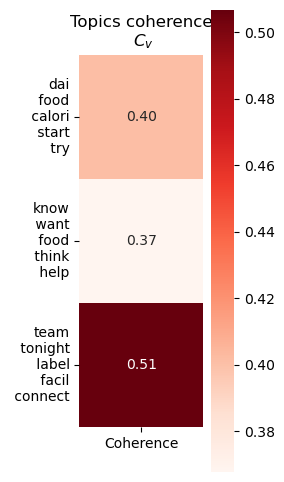

In [94]:
visualize_coherence_heatmap(stem_lda_model, stem_id2word, 3, stem)

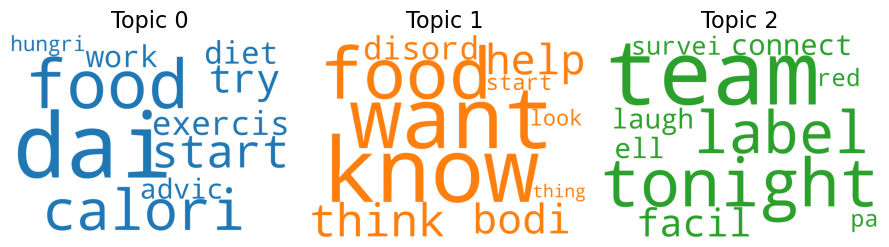

In [181]:
visualize_wordcloud(stem_lda_model, 1, 3)

In [204]:
visualize_tsne(stem_lda_model, stem_corpus, 3, 'Stemming')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15264 samples in 0.005s...
[t-SNE] Computed neighbors for 15264 samples in 0.348s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15264
[t-SNE] Computed conditional probabilities for sample 2000 / 15264
[t-SNE] Computed conditional probabilities for sample 3000 / 15264
[t-SNE] Computed conditional probabilities for sample 4000 / 15264
[t-SNE] Computed conditional probabilities for sample 5000 / 15264
[t-SNE] Computed conditional probabilities for sample 6000 / 15264
[t-SNE] Computed conditional probabilities for sample 7000 / 15264
[t-SNE] Computed conditional probabilities for sample 8000 / 15264
[t-SNE] Computed conditional probabilities for sample 9000 / 15264
[t-SNE] Computed conditional probabilities for sample 10000 / 15264
[t-SNE] Computed conditional probabilities for sample 11000 / 15264
[t-SNE] Computed conditional probabilities for sample 12000 / 15264
[t-SNE] Computed conditional probabilities for sam

Loading BokehJS ...

In [205]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(stem_lda_model, stem_corpus, stem_id2word)
pyLDAvis.save_html(p, 'lda_stem.html')
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.192590 -0.140477       1        1  61.520779
0     -0.139336  0.156352       2        1  36.769947
2      0.331926 -0.015875       3        1   1.709274, topic_info=          Term          Freq         Total Category  logprob  loglift
12         dai  16854.000000  16854.000000  Default  30.0000  30.0000
46      calori   5463.000000   5463.000000  Default  29.0000  29.0000
184    exercis   3481.000000   3481.000000  Default  28.0000  28.0000
59        food  15867.000000  15867.000000  Default  27.0000  27.0000
665     disord   5268.000000   5268.000000  Default  26.0000  26.0000
...        ...           ...           ...      ...      ...      ...
1292     hyper     65.914661     94.271914   Topic3  -5.5727   3.7113
10715  ontario     43.979257     61.563136   Topic3  -5.9774   3.7328
4941     color     47.194857     80.006214   Topic3  -5.9068   3.5413
8855       iop     49.849771    193.451041   Topic3  -5.8521   2.7131
582     provid     45.269032    253.509000   Topic3  -5.9485   2.3463

[229 rows x 6 columns], token_table=       Topic      Freq     Term
term                           
1          1  0.432684    advic
1          2  0.567389    advic
22331      2  0.032194  aliment
22331      3  0.965829  aliment
1838       1  0.997449   anorex
...      ...       ...      ...
474        2  0.022149     zone
474        3  0.974572     zone
5303       1  0.024738      “do
5303       2  0.024738      “do
5303       3  0.940052      “do

[412 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 1, 3])

In [96]:
spacy_lda_model = implement_lda(spacy_corpus, spacy_id2word, spacy_text, 2)

[(0,
  '0.017*"know" + 0.016*"get" + 0.015*"want" + 0.015*"go" + 0.011*"really" + '
  '0.010*"make" + 0.010*"even" + 0.009*"think" + 0.009*"food" + 0.008*"start"'),
 (1,
  '0.042*"food" + 0.020*"calorie" + 0.010*"snack" + 0.010*"drink" + '
  '0.009*"hungry" + 0.007*"taste" + 0.006*"cook" + 0.006*"sugar" + '
  '0.006*"diet" + 0.005*"use"')]
Coherence Score:  0.4526722993263453
Topic Coherence Score:  [0.3737492383424138, 0.5315953603102768]


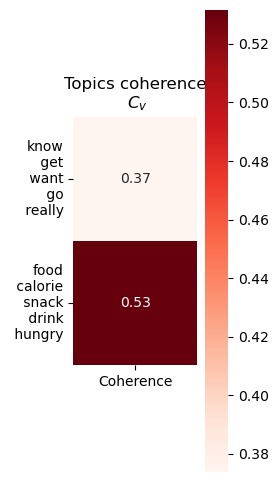

In [97]:
visualize_coherence_heatmap(spacy_lda_model, spacy_id2word, 2, lem)

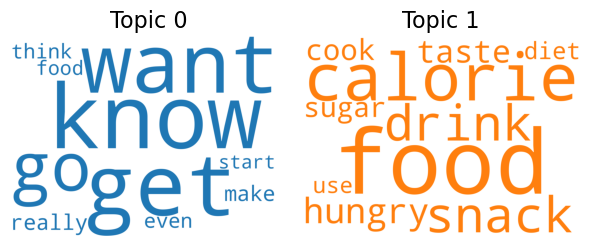

In [182]:
visualize_wordcloud(spacy_lda_model, 1, 2)

In [207]:
visualize_tsne(spacy_lda_model, spacy_corpus, 2, 'Lemmatization')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15264 samples in 0.004s...
[t-SNE] Computed neighbors for 15264 samples in 0.154s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15264
[t-SNE] Computed conditional probabilities for sample 2000 / 15264
[t-SNE] Computed conditional probabilities for sample 3000 / 15264
[t-SNE] Computed conditional probabilities for sample 4000 / 15264
[t-SNE] Computed conditional probabilities for sample 5000 / 15264
[t-SNE] Computed conditional probabilities for sample 6000 / 15264
[t-SNE] Computed conditional probabilities for sample 7000 / 15264
[t-SNE] Computed conditional probabilities for sample 8000 / 15264
[t-SNE] Computed conditional probabilities for sample 9000 / 15264
[t-SNE] Computed conditional probabilities for sample 10000 / 15264
[t-SNE] Computed conditional probabilities for sample 11000 / 15264
[t-SNE] Computed conditional probabilities for sample 12000 / 15264
[t-SNE] Computed conditional probabilities for sam

Loading BokehJS ...

In [208]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(spacy_lda_model, spacy_corpus, spacy_id2word)
pyLDAvis.save_html(p, 'lda_lem.html')
p

PreparedData(topic_coordinates=              x    y  topics  cluster       Freq
topic                                           
0      0.181181  0.0       1        1  83.464772
1     -0.181181  0.0       2        1  16.535228, topic_info=         Term          Freq         Total Category  logprob  loglift
65       food  16547.000000  16547.000000  Default  30.0000  30.0000
49    calorie   4317.000000   4317.000000  Default  29.0000  29.0000
273    hungry   2888.000000   2888.000000  Default  28.0000  28.0000
521     snack   2104.000000   2104.000000  Default  27.0000  27.0000
173     drink   2057.000000   2057.000000  Default  26.0000  26.0000
...       ...           ...           ...      ...      ...      ...
95      thing    760.127286   6745.364190   Topic2  -5.5217  -0.3834
378      make    753.753449  10666.341179   Topic2  -5.5301  -0.8501
1058   finish    552.105952    891.057872   Topic2  -5.8414   1.3210
104      also    628.684798   6153.077358   Topic2  -5.7115  -0.4814
68        get    592.916247  15776.688791   Topic2  -5.7701  -1.4816

[165 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
104       1  0.897762      also
104       2  0.102225      also
234       1  0.976904    always
234       2  0.023028    always
3590      1  0.999279  anorexia
...     ...       ...       ...
103       2  0.021448       way
369       1  0.976721      well
369       2  0.023325      well
766       1  0.004599    yogurt
766       2  0.998018    yogurt

[264 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2])

In [99]:
bigram_lda_model = implement_lda(bigram_corpus, bigram_id2word, bigram_text, 4)

[(0,
  '0.024*"symptom" + 0.016*"helpful" + 0.010*"tonight" + 0.008*"stop_think" + '
  '0.008*"harm" + 0.007*"major" + 0.007*"service" + 0.007*"smell" + '
  '0.006*"sensitive" + 0.006*"tell_need"'),
 (1,
  '0.015*"ed" + 0.015*"know" + 0.011*"start" + 0.010*"think" + 0.009*"get" + '
  '0.009*"go" + 0.008*"much" + 0.008*"also" + 0.008*"still" + 0.008*"lose"'),
 (2,
  '0.016*"know" + 0.013*"want" + 0.011*"say" + 0.010*"go" + 0.010*"even" + '
  '0.009*"tell" + 0.009*"get" + 0.008*"think" + 0.008*"make" + 0.008*"help"'),
 (3,
  '0.038*"food" + 0.010*"go" + 0.007*"hungry" + 0.007*"throw" + '
  '0.007*"usually" + 0.007*"snack" + 0.006*"make" + 0.006*"thing" + '
  '0.006*"sometimes" + 0.006*"try"')]
Coherence Score:  0.40797331248532803
Topic Coherence Score:  [0.5679236921185327, 0.33941255118981706, 0.36298569051395335, 0.36157131611900906]


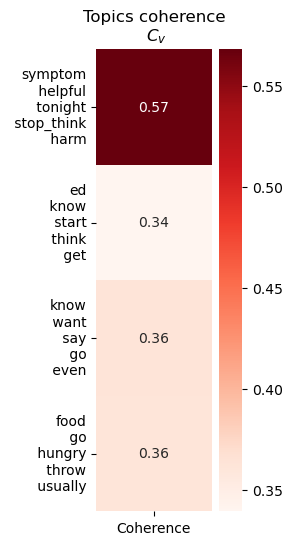

In [100]:
visualize_coherence_heatmap(bigram_lda_model, bigram_id2word, 4, lem_bigram)

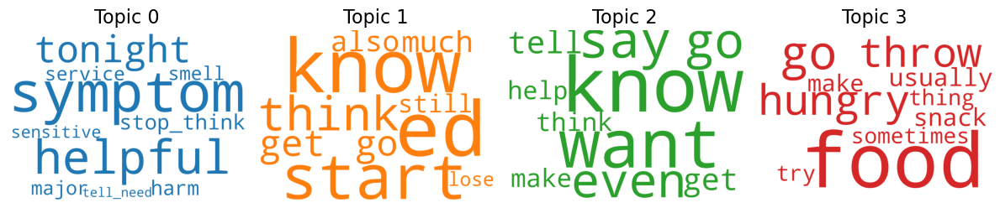

In [183]:
visualize_wordcloud(bigram_lda_model, 1, 4)

In [209]:
visualize_tsne(bigram_lda_model, bigram_corpus, 4, 'Lemmatization and Bigram')

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15033 samples in 0.008s...
[t-SNE] Computed neighbors for 15033 samples in 0.280s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15033
[t-SNE] Computed conditional probabilities for sample 2000 / 15033
[t-SNE] Computed conditional probabilities for sample 3000 / 15033
[t-SNE] Computed conditional probabilities for sample 4000 / 15033
[t-SNE] Computed conditional probabilities for sample 5000 / 15033
[t-SNE] Computed conditional probabilities for sample 6000 / 15033
[t-SNE] Computed conditional probabilities for sample 7000 / 15033
[t-SNE] Computed conditional probabilities for sample 8000 / 15033
[t-SNE] Computed conditional probabilities for sample 9000 / 15033
[t-SNE] Computed conditional probabilities for sample 10000 / 15033
[t-SNE] Computed conditional probabilities for sample 11000 / 15033
[t-SNE] Computed conditional probabilities for sample 12000 / 15033
[t-SNE] Computed conditional probabilities for sam

Loading BokehJS ...

In [210]:
pyLDAvis.enable_notebook()
p = pyLDAvis.gensim.prepare(bigram_lda_model, bigram_corpus, bigram_id2word)
pyLDAvis.save_html(p, 'lda_lem_bigram.html')
p

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.149948 -0.132772       1        1  40.316949
1     -0.150324 -0.052389       2        1  39.147116
3     -0.051601  0.230343       3        1  18.782165
0      0.351873 -0.045182       4        1   1.753770, topic_info=         Term         Freq        Total Category  logprob  loglift
57       food  8451.000000  8451.000000  Default  30.0000  30.0000
314        ed  5929.000000  5929.000000  Default  29.0000  29.0000
32        say  4763.000000  4763.000000  Default  28.0000  28.0000
546      tell  3841.000000  3841.000000  Default  27.0000  27.0000
272    hungry  1490.000000  1490.000000  Default  26.0000  26.0000
...       ...          ...          ...      ...      ...      ...
7889    smell   113.658214   121.623796   Topic4  -4.9914   3.9757
31948     pas    66.583896    71.524229   Topic4  -5.5261   3.9718
9409     harm   130.989937   175.977669   Topic4  -4.8495   3.7482
4108       de    91.125435   155.633656   Topic4  -5.2124   3.5081
4290    phone    78.079148   179.315208   Topic4  -5.3669   3.2120

[303 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
200       1  0.065217     advice
200       2  0.901322     advice
200       3  0.033118     advice
404       1  0.279264       also
404       2  0.523710       also
...     ...       ...        ...
127       3  0.160554       work
1883      3  0.998803      wrong
491       1  0.001580  yesterday
491       3  0.998632  yesterday
199       3  0.998344        yet

[517 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 2, 4, 1])

##### Interpretation

We can see that all three methods gives low coherence score lower than 0.5. We expected thie result as we have found out with EDA that there are many terms occuring in majority of documents that are not covered by nltk's stopwords. In fact, our results are better than expected. This is primarily because we added some common words to the stop words list. Hence, for each topic in each of the three final LDA models, we get relatively limited overlapping topic representation tokens. In other words, if the models output high coherence score, it means all topics are relatively segmented and that does not fit our understanding of our text data. 

**Stemming Model:** For Stemming, we achieve a highest average coherence score of 0.42 with a model of 3 topics. The most distinct topic is Topic 2 with a coherence score of 0.51. However, when we look at the top 10 words(*team, tonight, label, facil, connect, ell, laugh, survei, red, pa*) identifying this topic cluster, we find them having limited interpretability. In the pyLDAvis, we can check the size of the topics. Topic 2 occupies only 1.7% of the dataset. This is a very small cluster and is likely a result by chance. The remaining two topics are more informative. Looking at the top 10 words, Topic 0 seems to be focused on discussions about daily calorie intake and exercise. In comparison, Topic 1's top 10 keywords contains more terms signaling opinion expression like *know, want, think, and help*. It also contains "disord" which is the stemmed form of "disorder." We could infer that Topic 0 focus on general advice seeking and record keeping of food and exercise for weight loss while Topic 1 focus on expressing feelings plus seeking help with ED experience. 

**Lemmatization Model:** For Lemmatization, we achieve the highest average coherence score of 0.45 with a model of 2 topics. The most distinct topic is Topic 1, with a coherence score of 0.53. Examining the top 10 words (*food, calorie, snack, drink, hungry, taste, cook, sugar, diet, use*), this topic is clearly centered around food, dietary choices, and nutrition. In the pyLDAvis visualization, we can check the size of the topics. It contains 83.5% of the tokens. Comparing Topic 1 with Topic 0, which has a lower coherence score of 0.37, we see that its top 10 words (*know, get, want, go, really, make, even, think, food, start*) suggest a focus on personal thoughts, intentions, and actions related to food and lifestyle. This is similar to Topic 1 in the stemming model, where individuals express opinions and seek help. Overall, the Lemmatization model provides better coherence and clearer topic separation than the Stemming model.

**Lemmatization + Bigram Model:** For Lemmatization with bigrams, we achieve the highest average coherence score of 0.41 with a model of 4 topics. The most distinct topic is Topic 0, with a coherence score of 0.57. Looking at its top 10 words (*symptom, helpful, tonight, stop_think, harm, major, service, smell, sensitive, tell_need*), this topic appears to relate to symptoms, mental states, and seeking help. The remaining topics have lower coherence scores, indicating weaker interpretability. Topic 1 (*ed, know, start, think, get, go, much, also, still, lose*) seems to focus on experiences and struggles related to eating disorders. Topic 2 (*know, want, say, go, even, tell, get, think, make, help*) is more conversational, centering on thoughts, expressions, and seeking advice. Topic 3 (*food, go, hungry, throw, usually, snack, make, thing, sometimes, try*) aligns closely with discussions about food habits, hunger, and eating patterns. Compared to the Lemmatization model, the inclusion of bigrams helps capture more nuanced phrases like *stop_think* and *tell_need*, but the overall coherence score is slightly lower, suggesting that the additional topics may introduce some noise. Also, looking at the visualization, we can spot a large overlap between Topic 1 and Topic 2, each containing approximately 40% of the token. This overlap is likely due to the similar terms indicating thoughts and feelings.

For tSNA clustering visualization, we observe curves of condensed dots for the Stemming Model and Lemmatization Model and much more scattered points for Lemmatization + Bigram Model. The spirals are likely a result of low-dimensional representation of high-dimensional data which optimizes on preserving local structure(we are only considering 91 neighbors in our visualize_tsne() function). However, we observe well-seperated clusters in all three cases(especially Lemmatization + Bigram Model), this suggests the assignmenr of documents are relatively distinct and the models are producing coherent topics.

##### Error Analysis

For unsupervised learning techniques, we do not know the true value. While we do know the subreddit each post belongs to, predicting subreddit is not our goal here. We understands that there are overlaps in content themes between the subreddits, hence, predicting subreddits is a trivial task. We want to explore the topics discussed in the combination of posts from the subreddits. So, we focus on model interpretation. 

##### Reflection

Better LDA model performance may be achieved if we iteratively add more stopwords. However, that is time consuming. Instead, we move on to explore other topic modeling methods which not only takes into account number of occurances of tokens but also their relative position using embedding techniques. 

#### **Topic Modeling with BERTopic**

BERTopic leverages transformer-based embeddings and hierarchical clustering to identify topics with more contextual depth. It is essentially a pipeline of models. In this section , we will first explore how BERTopic works. Then, we will build a BERTopic model that works best for our data.  
According to the official BERTopic documentation, it contains mainly the following steps:  
        **1. Embed documents;  
        2. Dimensionality reduction;  
        3. Cluster Documents;  
        4. Bag-of-words;  
        5. Topic representation;  
        6. (optional)Fine-tune Topic Representation.** 

In [102]:
from bertopic import BERTopic

##### Drop Short, Repeated Entries

Similarly to the data preparation processes of LDA models, we drop the short repeated entries from our text data. We do not use text directly as we have done some preprocessing on text. BERTopic modeling does not require nor recommend data preprocessing. So, we load the text data again and save it as docs. We use docs as input data for BERTopic modeling.

In [103]:
docs = data[data['selftext'].str.len() > 280].selftext.unique()

We import the necessary packages for BERTopic and reset our stopwords to default nltk stopwords for English.

In [104]:
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from bertopic.vectorizers import ClassTfidfTransformer
from bertopic.representation import KeyBERTInspired

stop_words = stopwords.words('english')

##### Step-by-step Breakdown of BERTopic Model

While we can directly use BERTopic() as our model, we want to explore the inner workings of this model and tweek parameters of sub-models at each step for better results. We will demonstrate a step-by-step breakdown of BERTopic Model with the following sub-models:

In [105]:
embedding_model = SentenceTransformer('all-MiniLM-L6-v2')
umap_model = UMAP(n_neighbors=250, n_components=2, min_dist=0, metric='cosine', random_state = 888)
hdbscan_model = HDBSCAN(min_cluster_size=250, min_samples=125,
                        gen_min_span_tree=True,
                        prediction_data=True)
vectorizer_model = CountVectorizer(ngram_range=(1, 2), stop_words=stop_words)
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
representation_model = KeyBERTInspired(random_state=888)

- Step 1: SentenceTransformer for Embedding Text Data

In [106]:
embedding_model

SentenceTransformer(
  (0): Transformer({'max_seq_length': 256, 'do_lower_case': False}) with Transformer model: BertModel 
  (1): Pooling({'word_embedding_dimension': 384, 'pooling_mode_cls_token': False, 'pooling_mode_mean_tokens': True, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
  (2): Normalize()
)

'all-MiniLM-L6-v2' is a pre-trained sentence transformer model. It maps sentences & paragraphs to a 384 dimensional dense vector space and can be used for tasks like clustering or semantic search. Given an input text, it outputs a vector which captures the semantic information. The sentence vector may be used for information retrieval, clustering or sentence similarity tasks.By default, input text longer than 256 word pieces is truncated. The training process of this model uses a large proportion of reddit comments collected from 2015 to 2018. Since our data is also from reddit. We decided to use this model as our embedding model. 

In [107]:
from tqdm.auto import tqdm
batch_size = 32
n = len(docs)

embeds = np.zeros((n, embedding_model.get_sentence_embedding_dimension()))

for i in tqdm(range(0, n, batch_size)):
    i_end = min(i+batch_size, n)
    batch = docs[i:i_end]
    batch_embed = embedding_model.encode(batch)
    embeds[i:i_end,:] = batch_embed

  0%|          | 0/477 [00:00<?, ?it/s]

In [108]:
embeds.shape

(15264, 384)

The shape of embedding results is 15,6  x 384. This means for every document in our docs, the model maps the document(post's selftext) to a 384 dimensional dense vector space.

- Step 2: UMAP Model for Dimensionality Reduction

First, we import the plotting function provided by umap for visualization.

In [109]:
import umap.plot

Since the aim of this section is preliminary exploration of steps of BERTopic model, we start by creating a umap model with n_components=2. This means that we want to reduce the 384 dimensions generated by the embedding model in 2 dimensions. 

In [110]:
umap_model

UMAP(metric='cosine', min_dist=0, n_neighbors=250, random_state=888)

In [111]:
mapper = umap_model.fit(embeds)

In [112]:
u = umap_model.fit_transform(embeds)

In [113]:
u.shape

(15264, 2)

In [114]:
mapper

UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=250, random_state=888, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

mapper is the model generated by our embeddings and u is the results.

We can plot a 2D scatterplor graph to examine the distribution of points after performing dimension reduction. 

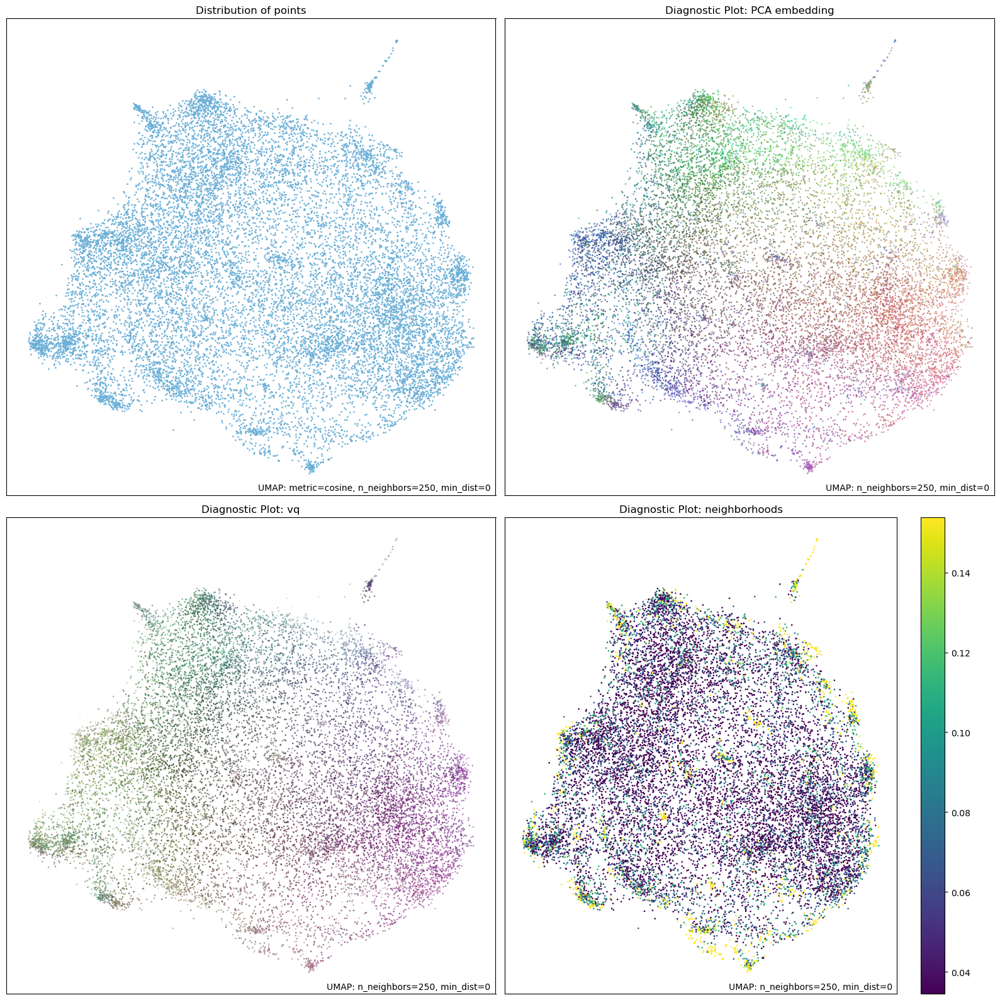

In [115]:
fig, axes = plt.subplots(2, 2, figsize=(16, 16))
axes = axes.flatten()
umap.plot.points(mapper,ax=axes[0])
umap.plot.diagnostic(mapper, diagnostic_type='pca',ax=axes[1])
umap.plot.diagnostic(mapper, diagnostic_type='vq',ax=axes[2])
umap.plot.diagnostic(mapper, diagnostic_type='neighborhood',ax=axes[3])
axes[0].set_title(f'Distribution of points')
axes[1].set_title(f'Diagnostic Plot: PCA embedding')
axes[2].set_title(f'Diagnostic Plot: vq')
axes[3].set_title(f'Diagnostic Plot: neighborhoods')
plt.tight_layout()
plt.show()

The above graph is the visualizations of basic distribution of points and diagnostic plots of the results from umap model with n_components equals 2. Observe the upper left graph, we can see that while there are some areas with more densely distributed points. The points are scattered rather evenly and forms one giant cluster. Similarly in the PCA diagnostic graph(upper right), we observe sharper, clearer color on the edges of the cluster. Points indicated by each clear color are more similar to each other. In the middle of the cluster, the colors are more randomly distributed, resulting in a chaos mess. For the neighborhood diagnostic plot(lower right), it tells how well local neighborhoods are preserved with higher value indicating better preservation. We also plot higher values on the edge of the cluster. Vector quantization(lower left) effectively finds 3 representative centers for the data, and then describes each data point in terms of its distance to these centers. We see a mix of colors and some clearer, sharper color on the edge.

Similarly, we can implement a umap model which reduces the 384 dimensions to 3 dimensions and draw visualization. 

In [116]:
umap_model_3d = UMAP(n_neighbors=250, n_components=3, min_dist=0, metric='cosine', random_state = 888)

In [117]:
umap_model_3d

UMAP(metric='cosine', min_dist=0, n_components=3, n_neighbors=250, random_state=888)

In [118]:
u_3d = umap_model_3d.fit_transform(embeds)

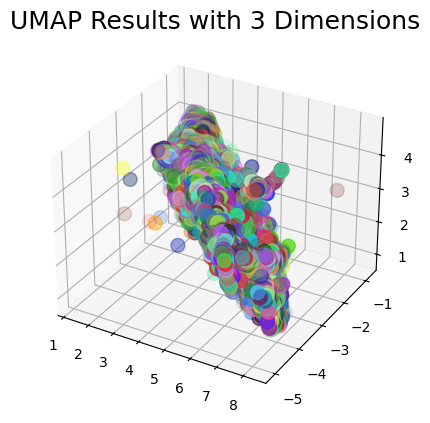

In [119]:
colors = np.random.rand(15264, 4)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(u[:,0], u_3d[:,1], u_3d[:,2], c=colors, s=100)
plt.title('UMAP Results with 3 Dimensions', fontsize=18);

Unfortunately, diagnostic plots are only implemented for 2D models. So, we are unable to draw the same four plots as we did for umap with n_components = 2. However, we can still directly observe that the distribution of points are really close to eachb other and not forming seperate clusters when n_componenet is 3. 

Thus, we know that we should try to find the appropriate number of components for umap model so it produces meaningful results. We can employ PCA to find a good number of components using the elbow method. 

**Use PCA to find how many components needed**

In [120]:
from sklearn import decomposition

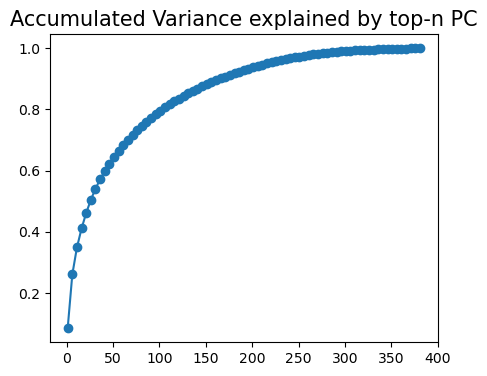

In [121]:
plt.figure(figsize=(5, 4))
plt.title('Accumulated Variance explained by top-n PC', fontsize=15)
accumulated_variance = []
num_components = []
for i in range(1, 384, 5):
    pca = decomposition.PCA(n_components=i)
    pca.fit(embeds)
    X_pca = pca.transform(embeds)
    accumulated_variance.append(sum(pca.explained_variance_ratio_))
    num_components.append(i)
plt.plot(num_components, accumulated_variance, 'o-') 
plt.show()

In [122]:
from kneed import KneeLocator
n = range(1, 385)

33


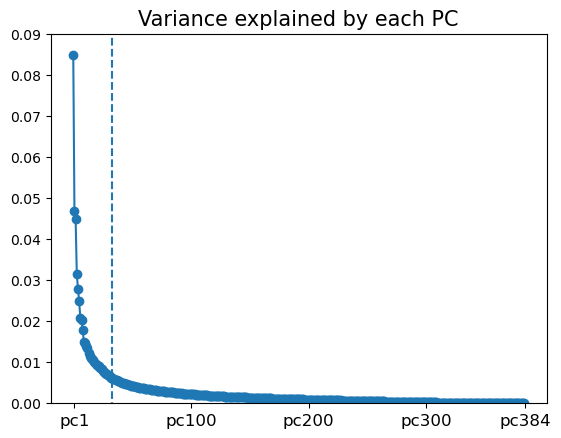

In [123]:
n_components_lst = [1, 100, 200, 300, 384]
pca = decomposition.PCA(n_components=384)
pca.fit(embeds)
kn = KneeLocator(n, pca.explained_variance_ratio_, curve='convex', direction='decreasing')
print(kn.knee)
plt.plot(pca.explained_variance_ratio_,'o-')
plt.xticks(n_components_lst,[f'pc{i}' for i in n_components_lst], fontsize=12)
plt.vlines(kn.knee, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
plt.ylim(0,0.09)
plt.title('Variance explained by each PC', fontsize=15);

We found the point at which the variance explained by each PC by number of PC's gradient is smallest. It is at PC 33. This is the number of components we will pass to out model. This means that most of the important information is captured by 33 components, and using more than that might add unnecessary complexity.

In [124]:
umap_model = UMAP(n_neighbors=250, n_components=33, min_dist=0, metric='cosine', random_state = 888)

In [125]:
u = umap_model.fit_transform(embeds)

- Step 3: HDBSCAN Model for Clustering

Hierarchical Density-Based Spatial Clustering of Applications with Noise group similar text embeddings into clusters, where each cluster represents a potential topic. It automatically determines the optimal number of topics based on density rather than requiring a predefined topic count. It can find clusters of different shapes and has the nice feature of identifying outliers where possible. As a result, we do not force documents into a cluster where they might not belong. 

In [126]:
hdbscan_model

HDBSCAN(gen_min_span_tree=True, min_cluster_size=250, min_samples=125,
        prediction_data=True)

In [127]:
clustering = hdbscan_model.fit_predict(u)

We can print out the clustering result for each document. -1 indicates the document is not clustered into any clusters.

In [128]:
clustering

array([-1, -1, -1, ..., -1, -1, -1])

In [129]:
len(clustering)

15264

In [130]:
values, counts = np.unique(clustering, return_counts=True)
values, counts

(array([-1,  0,  1,  2,  3,  4]), array([8484,  917, 2686, 1818,  453,  906]))

We have 5 clusters of size 917, 2686, 1818,  453,  906. We have 8484 unclustered documents.

We can visualize the condensed_tree of the clustering:

<Axes: ylabel='$\\lambda$ value'>

/opt/anaconda3/envs/macs30120/lib/python3.9/site-packages/matplotlib/transforms.py:2060: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self._mtx[1, 0] *= sy
/opt/anaconda3/envs/macs30120/lib/python3.9/site-packages/matplotlib/transforms.py:2061: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self._mtx[1, 1] *= sy
/opt/anaconda3/envs/macs30120/lib/python3.9/site-packages/matplotlib/transforms.py:2062: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  self._mtx[1, 2] *= s

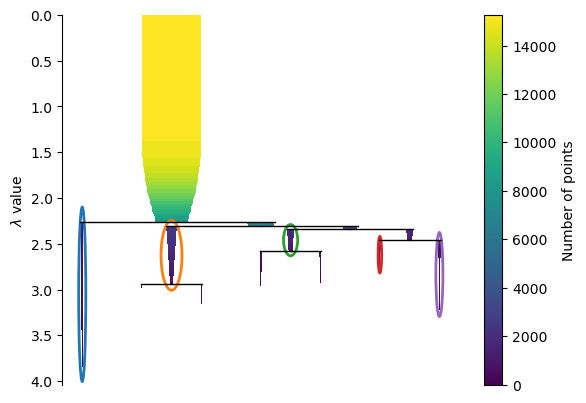

In [131]:
hdbscan_model.condensed_tree_.plot(select_clusters=True, selection_palette=sns.color_palette())

Notice here the blue circle is of highest hierarchy, followed by orange, green, and red and purple are on the same level. Being on a lower level means more specialized, specfic cluster and being on higher level means broader topics. In addition, no further splits indicates it is hard to identify any further subtopic.

- STEP 4: Vectorizer for Topic Representation: Bag-of-words for Each Cluster

Now that we have our clustered documents. We want to be able to represent them when returning the results. We use count vectorizer to create a bag-of-words for each cluster.

In [132]:
clustered_docs_data = {'docs': docs, 'cluster': clustering}

In [133]:
clustered_docs = pd.DataFrame(clustered_docs_data)

In [134]:
docs_per_class = clustered_docs.groupby(['cluster'], as_index=False).agg({'docs': ' '.join})

In [135]:
vectorizer_result = vectorizer_model.fit_transform(docs_per_class.docs)

In [136]:
vectorizer_result = []
for i in values:
    text_data_by_cluster = clustered_docs[clustered_docs['cluster'] == i]['docs']
    vectorizer_result.append(vectorizer_model.fit_transform(text_data_by_cluster))

In [137]:
vectorizer_result

[<8484x463425 sparse matrix of type '<class 'numpy.int64'>'
 	with 1447061 stored elements in Compressed Sparse Row format>,
 <917x83228 sparse matrix of type '<class 'numpy.int64'>'
 	with 179836 stored elements in Compressed Sparse Row format>,
 <2686x176100 sparse matrix of type '<class 'numpy.int64'>'
 	with 483233 stored elements in Compressed Sparse Row format>,
 <1818x130628 sparse matrix of type '<class 'numpy.int64'>'
 	with 296473 stored elements in Compressed Sparse Row format>,
 <453x43510 sparse matrix of type '<class 'numpy.int64'>'
 	with 81068 stored elements in Compressed Sparse Row format>,
 <906x55526 sparse matrix of type '<class 'numpy.int64'>'
 	with 117758 stored elements in Compressed Sparse Row format>]

- Step 5: class-based TF-IDF for Topic Representation: Common Words Removal

Motivation: Some words appear quite often in every topic but are generally not considered stop words as found in the CountVectorizer(stop_words="english") list. To further reduce these frequent words, we can use reduce_frequent_words to take the square root of the term frequency after applying the weighting scheme.

c-TF-IDF can best be explained as a TF-IDF formula adopted for multiple classes by joining all documents per class. Thus, each class is converted to a single document instead of set of documents. The frequency of each word x is extracted for each class c and is l1 normalized. This constitutes the term frequency. Then, the term frequency is multiplied with IDF which is the logarithm of 1 plus the average number of words per class A divided by the frequency of word x across all classes. 

In [138]:
words_per_class = dict()
for i in np.unique(clustering):
    words = vectorizer_model.get_feature_names_out()
    ctfidf_results = ctfidf_model.fit_transform(vectorizer_result[-1])
    ctfidf_results = ctfidf_results.toarray()
    words_per_class[i] = [words[index] for index in ctfidf_results[i].argsort()[-10:]]

In [139]:
pd.DataFrame(words_per_class)

,-1,0,1,2,3,4
0,least 15k,medication want,struggled body,picky severe,gobbling still,walking round
1,walk least,mind shut,brownies etc,picky kid,want buy,easy want
2,would busy,currently reading,etc none,like sorry,almost want,variation
3,busy amount,low 177,quite tried,want become,things perspective,basket
4,forward busy,snack currently,worked get,picky,still tomorrow,putting nothing
5,15k steps,noise rushing,find another,charge,fine food,definitely want
6,15k,got medication,etc within,safety,style,really simple
7,home first,medication little,rice beef,charge food,accept always,binge end
8,college looking,want baby,due binging,pops,gobbling,struggle find
9,day distracted,246,rid binging,safety food,okay eat,easy recipes


- Step 6: Optional Fine-Tuning for Topic Representation: KeyBERTInspired()

The KeyBertInspired representation model takes in tje calculated c-TF-IDF representation of the top n representative documents for each topic and uses them to identify key words that best characterize each topic.  
The process begins by extracting the n most representative documents per topic. To achieve this, a set of candidate documents is first sampled from each cluster, with the number of candidates controlled by the nr_samples parameter(we use the default value 500). These candidate documents are then evaluated through their c-TF-IDF representation, and the top n representative documents are selected based on cosine similarity to the topic’s c-TF-IDF representation. Subsequently, the top n words for each topic are extracted, determined by their c-TF-IDF scores, with the number of representative documents considered controlled by the nr_repr_docs parameter(default: 5). The embeddings for the words and the representative documents are then obtained, and topic embeddings are created by averaging the embeddings of the selected representative documents. Finally, the most similar words to each topic are identified by calculating the cosine similarity between the word embeddings and the topic embeddings, revealing the terms that best represent the core themes of the topic.  
So, the top n words representation for each topic generated by the c-TF-IDF model serves as a suggestion. It does not necessarily equal the final representation when KeyBERTInspired() is introduced. 

##### Complete Model

We can directly implement the completer BERTopic model:

In [140]:
embedding_model = SentenceTransformer('all-MiniLM-L6-v2')
umap_model = UMAP(n_neighbors=150, n_components=33, min_dist=0, random_state = 888)
hdbscan_model = HDBSCAN(min_cluster_size=250, min_samples=125,
                        gen_min_span_tree=True,
                        prediction_data=True)
vectorizer_model = CountVectorizer(ngram_range=(1, 2), stop_words=stop_words)
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
representation_model = KeyBERTInspired(random_state=888)

In [141]:
model = BERTopic(
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    embedding_model=embedding_model,
    vectorizer_model=vectorizer_model,
    ctfidf_model=ctfidf_model,
    representation_model=representation_model,
    top_n_words=10,
    language='english',
    calculate_probabilities=True,
    verbose=True
)
topics, probs = model.fit_transform(docs)

2025-03-09 00:10:46,054 - BERTopic - Embedding - Transforming documents to embeddings.


Batches:   0%|          | 0/477 [00:00<?, ?it/s]

2025-03-09 00:19:25,099 - BERTopic - Embedding - Completed ✓
2025-03-09 00:19:25,120 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-03-09 00:20:39,557 - BERTopic - Dimensionality - Completed ✓
2025-03-09 00:20:39,564 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-03-09 00:20:43,987 - BERTopic - Cluster - Completed ✓
2025-03-09 00:20:44,005 - BERTopic - Representation - Extracting topics from clusters using representation models.
2025-03-09 00:21:09,861 - BERTopic - Representation - Completed ✓


Great! We have fitted and transformed out data with BERTopic model. Let's check the topic information:

In [142]:
info = model.get_topic_info()
info

,Topic,Count,Name,Representation,Representative_Docs
0,-1,8772,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f..."
1,0,2695,0_losing weight_weight loss_lose weight_exercise,"[losing weight, weight loss, lose weight, exer...","[This is kind a late new year's post, but I wa..."
2,1,973,1_binge eating_eating_eat_food noise,"[binge eating, eating, eat, food noise, hunger...",[rant because i can’t hold it in anymore and i...
3,2,964,2_eating disorder_disorder_advice_sister,"[eating disorder, disorder, advice, sister, sh...",[\nTW: I am not tech savvy and I will not incl...
4,3,543,3_recovery_relapse_eating disorder_recover,"[recovery, relapse, eating disorder, recover, ...",[TW: >!suicide attempt!< \n\nHoly shit I feel ...
5,4,517,4_meals_meal_eating_low calorie,"[meals, meal, eating, low calorie, diet, eat, ...",[My starting weight was 380 and my lowest was ...
6,5,493,5_weight loss_skinny_obese_overweight,"[weight loss, skinny, obese, overweight, fat, ...",[Hey everybody! I am very much on the journey ...
7,6,307,6_weight loss_loose skin_waist_thighs,"[weight loss, loose skin, waist, thighs, belly...",[Hi! It'd be nice if I could get an input on t...


The results above show that BERTopic has generated 7 topics. 8,772 documents are not classified into any of the 7 topics. Currently, the representative words for each topic are trucated. Let's print them out to get a better understanding of the conetent of the topics:

In [143]:
for i in range(8):
    print(info['Representation'][i])

['weight loss', 'lose weight', 'diet', 'eating', 'eat', 'calorie', 'fat', 'calories', 'lose', 'healthy']
['losing weight', 'weight loss', 'lose weight', 'exercise', 'calorie deficit', 'diet', 'workout', 'workouts', 'weight', 'weigh']
['binge eating', 'eating', 'eat', 'food noise', 'hunger', 'meals', 'hungry', 'meal', 'binging', 'food']
['eating disorder', 'disorder', 'advice', 'sister', 'shes', 'relationship', 'mother', 'eating', 'upset', 'mom']
['recovery', 'relapse', 'eating disorder', 'recover', 'therapy', 'inpatient', 'treatment', 'outpatient', 'get better', 'ed']
['meals', 'meal', 'eating', 'low calorie', 'diet', 'eat', 'calorie', 'hungry', 'recipes', 'snack']
['weight loss', 'skinny', 'obese', 'overweight', 'fat', 'weight', 'thin', 'lose', 'bmi', 'fat people']
['weight loss', 'loose skin', 'waist', 'thighs', 'belly', 'fat', 'loose', 'fit', 'jeans', 'wear']


Similarly to LDA modeling, we can also compute coherence scores for our BERTopic model:

In [144]:
# Preprocess documents
cleaned_docs = model._preprocess_text(docs)

# Extract vectorizer and tokenizer from BERTopic
vectorizer = model.vectorizer_model
tokenizer = vectorizer.build_tokenizer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names_out()
tokens = [tokenizer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in model.get_topic(topic)] 
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')

coherence = coherence_model.get_coherence()
coherence_per_topic = coherence_model.get_coherence_per_topic()

In [145]:
coherence

0.6031276185208857

The overall coherence score is 0.60. This is much higher than our three final LDA models. BERTopic performs much better than LDA. We argue that this is because the use of embedding techniques which captures more nuanced semantic meanings in eahc document. 

In [146]:
coherence_per_topic

[0.5474744582846484,
 0.5989475623304734,
 0.4932152832741714,
 0.7362808666269887,
 0.5483144166596855,
 0.5754309910715034,
 0.7222297513987289]

We also get the coherence score per topic. We can add this information to our info dataframe:

In [147]:
info['Coherence'] = [coherence ]+ coherence_per_topic

In [148]:
info

,Topic,Count,Name,Representation,Representative_Docs,Coherence
0,-1,8772,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f...",0.603128
1,0,2695,0_losing weight_weight loss_lose weight_exercise,"[losing weight, weight loss, lose weight, exer...","[This is kind a late new year's post, but I wa...",0.547474
2,1,973,1_binge eating_eating_eat_food noise,"[binge eating, eating, eat, food noise, hunger...",[rant because i can’t hold it in anymore and i...,0.598948
3,2,964,2_eating disorder_disorder_advice_sister,"[eating disorder, disorder, advice, sister, sh...",[\nTW: I am not tech savvy and I will not incl...,0.493215
4,3,543,3_recovery_relapse_eating disorder_recover,"[recovery, relapse, eating disorder, recover, ...",[TW: >!suicide attempt!< \n\nHoly shit I feel ...,0.736281
5,4,517,4_meals_meal_eating_low calorie,"[meals, meal, eating, low calorie, diet, eat, ...",[My starting weight was 380 and my lowest was ...,0.548314
6,5,493,5_weight loss_skinny_obese_overweight,"[weight loss, skinny, obese, overweight, fat, ...",[Hey everybody! I am very much on the journey ...,0.575431
7,6,307,6_weight loss_loose skin_waist_thighs,"[weight loss, loose skin, waist, thighs, belly...",[Hi! It'd be nice if I could get an input on t...,0.722230


We can also extract clustering results for each document:

In [149]:
results = model.get_document_info(docs)

In [150]:
results[:5]

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,"So, I'm kinda of a lurker, I don't comment her...",-1,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f...",weight loss - lose weight - diet - eating - ea...,0.662669,False
1,I’m going through a depressive episode right n...,-1,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f...",weight loss - lose weight - diet - eating - ea...,0.148177,False
2,I've been struggling with binge eating and hav...,-1,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f...",weight loss - lose weight - diet - eating - ea...,0.575366,False
3,"240+ lbs, 30M, fattest I’ve ever been Working...",-1,-1_weight loss_lose weight_diet_eating,"[weight loss, lose weight, diet, eating, eat, ...","[Hi everyone! Firstly, I’d like to apologize f...",weight loss - lose weight - diet - eating - ea...,0.455645,False
4,The past 4 days i've been eating about 1300 to...,0,0_losing weight_weight loss_lose weight_exercise,"[losing weight, weight loss, lose weight, exer...","[This is kind a late new year's post, but I wa...",losing weight - weight loss - lose weight - ex...,0.360755,False


This information will be particularly helpful as we do not only want to check the representative documents. We want to sample random documents in each cluster to see if they do fit with the topic modeling results.

##### Visualization

Before we move on to detailed interpretation of BERTopic results. We want to show several visualizations:

- Intertopic Distance Map

In [151]:
model.visualize_topics()

We observe high separation of between two topic groups. Topic 0, 4, 6 vs. Topic 1, 2, 3, 5. This suggests that the topics between the two groups are very different from each other while the topics from within each group are closer and more similar to each other. 

- Hierarchical Clustering

In [152]:
model.visualize_hierarchy()

- Documents and Topics

In [153]:
model.visualize_documents(docs, reduced_embeddings=u)

This visualization marks identified topic on the whole set of documents. We can see some distinct boundaries between identified topics. However, we must also note that there are 8,000+ documents unclustered represented by the grey dots. The elliptical shape also matches with what we observe from the intertopic distance map.

- Term Score Decline per Topic

In [154]:
model.visualize_term_rank()

This diagram visualizes the term score for top 10 words for each topic. The term score declines as we move on to the next most important word. Note the lowest line. This is the line for Topic 2. As we shall see in the Interpretation section, Topic 2 has lowest coherence score. This is consistent with it having a consistently lower term score for all top 10 words. 

- Topic Word Scores

In [155]:
model.visualize_barchart()

- Similarity Matrix Heatmap

In [156]:
model.visualize_heatmap()

The similarity matrix heatmap is consistent with our observation from the hierarchical clustering diagram: Topic 0, 4, 6 are more similar to each other and Topic 1, 2, 3, 5 are more similar to each other compared to similarity of topic pairs across the two groups. 

- Probability Distribution by Topic

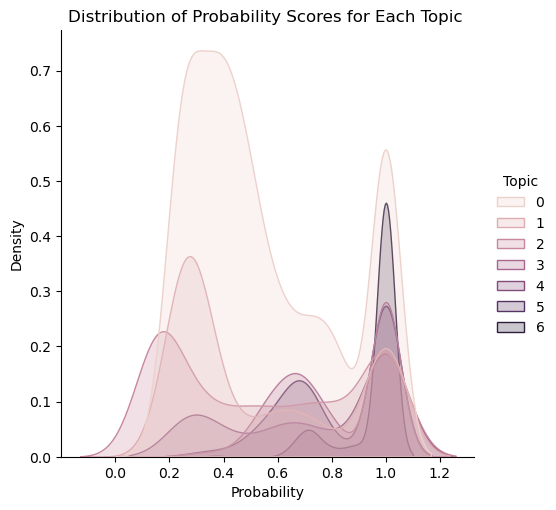

In [157]:
sns.displot(results[results['Topic'] != -1], 
            x='Probability',
            hue='Topic', 
            kind = 'kde',
            fill = True);
plt.title('Distribution of Probability Scores for Each Topic ')
plt.show()

##### Interpretation

We begin by analyzing each topic by their top 10 words, coherence score, and probability distribution:

**Topic 0:** Weight Loss & Exercise (Coherence Score: 0.547)
- Top Words:  
*losing weight, weight loss, lose weight, exercise, calorie deficit, diet, workout, workouts, weight, weigh*
- Interpretation:  
This topic covers general weight loss strategies, including exercise routines, workouts, calorie deficits, and dieting. It suggests discussions about fitness journeys, weight tracking, and strategies for effective weight loss.
- Coherence Analysis:  
A moderate coherence score (0.547) suggests that the words are fairly well-connected but may include slightly overlapping concepts (e.g., weight tracking vs. fitness methods).
- Probability Distribution:  
This topic has a high peak around 0.4, suggesting that many documents are weakly to moderately associated with this topic. It also has a noticeable density around 1.0, indicating that some documents are strongly assigned to this topic.


**Topic 1:** Binge Eating & Food-Related Behaviors (Coherence Score: 0.599 🥉)
- Top Words:  
*binge eating, eating, eat, food noise, hunger, meals, hungry, meal, binging, food*
- Interpretation:  
This topic revolves around binge eating, food-related thoughts ("food noise"), hunger, and meal patterns. The presence of binge, binging, food noise suggests conversations around compulsive eating, emotional eating, and hunger regulation.
- Coherence Analysis:  
A relatively high coherence score (0.599) indicates that the words strongly relate to each other, forming a clear theme centered on eating behavior and hunger management.
- Probability Distribution:  
Most documents in this topic have relatively low to moderate probability scores (~0.4), implying that the model is less confident in assigning documents to this topic. Unlike some other topics, it does not show a strong peak near 1.0, meaning few documents are highly confident matches for this topic.

**Topic 2:** Eating Disorders & Family Relationships (Coherence Score: 0.493 ⚠️)
- Top Words:  
*eating disorder, disorder, advice, sister, shes, relationship, mother, eating, upset, mom*
- Interpretation:  
This topic explores eating disorders in the context of family relationships, particularly interactions with mothers and sisters. Words like advice, upset, relationship suggest discussions about seeking guidance, dealing with concern from family members, and the emotional toll of eating disorders on loved ones.
- Coherence Analysis:  
A lower coherence score (0.493) suggests that while the topic is recognizable, it may contain some overlapping themes (e.g., mental health advice vs. family support) or less distinct clustering of words. Considering this topic also includes discussions about eating disorder behaviors and feelings, it is likely that the overlap with Topic 1 and Topic 3 results in low coherence score for this topic.
- Probability Distribution:  
This topic's probability distribution has multiple peaks, meaning documents are distributed across different probability levels. It has moderate confidence assignments.

**Topic 3:** Recovery & Treatment for Eating Disorders (Coherence Score: 0.736 – Highest Score 🥇)
- Top Words:  
*recovery, relapse, eating disorder, recover, therapy, inpatient, treatment, outpatient, get better, ed*
- Interpretation:  
This topic is strongly focused on eating disorder recovery and treatment, covering therapy (inpatient, outpatient), relapse prevention, and getting better. Discussions likely include personal recovery stories, seeking professional help, and mental health treatment approaches.
- Coherence Analysis:  
With the highest coherence score (0.736), this topic is well-defined and highly interpretable, suggesting a strong thematic connection between recovery-related terms.
- Probability Distribution:  
This topic's probability distribution has multiple peaks, meaning documents are distributed across different probability levels. It has moderate confidence assignments.

**Topic 4:** Dieting, Meal Planning, & Low-Calorie Foods (Coherence Score: 0.548)
- Top Words:  
*meals, meal, eating, low calorie, diet, eat, calorie, hungry, recipes, snack*
- Interpretation:  
This topic focuses on low-calorie dieting, meal planning, and food choices, with discussions likely covering healthy meal recipes, hunger management, and calorie-conscious eating.
- Coherence Analysis:  
A moderate coherence score (0.548) suggests that the topic is well-formed but may slightly overlap with general eating behaviors (e.g., Topic 1 on binge eating).
- Probability Distribution:  
This topic's probability distribution has multiple peaks, meaning documents are distributed across different probability levels. It has moderate confidence assignments.

**Topic 5:** Weight Perception & Body Image (Coherence Score: 0.575)
- Top Words:  
*weight loss, skinny, obese, overweight, fat, weight, thin, lose, bmi, fat people*
- Interpretation:  
This topic covers weight perception, body image, and societal views on weight categories. Terms like skinny, obese, overweight, bmi, fat people suggest discussions about body weight classifications, social stigma, and weight-related identity concerns.
- Coherence Analysis:  
A moderate-to-high coherence score (0.575) indicates that the topic is reasonably well-structured but may contain some overlap with weight loss discussions (Topic 0 & 6).
- Probability Distribution:  
The most prominent peaks around 0.9 to 1.0 indicate that many documents are strongly associated with these topics. The high-confidence peaks suggest that these topics are well-defined, and the model confidently assigns certain documents to them.

**Topic 6:** Weight Loss & Body Changes (Loose Skin & Fat Distribution) (Coherence Score: 0.722 – Second Highest Score 🥈)
- Top Words:  
*weight loss, loose skin, waist, thighs, belly, fat, loose, fit, jeans, wear*
- Interpretation:  
This topic addresses body changes after weight loss, with discussions likely focusing on loose skin, fat distribution, and fitting into clothes. Words like waist, thighs, belly, jeans, wear suggest concerns about body shape, clothing fit, and post-weight-loss body composition.
- Coherence Analysis:  
With a high coherence score (0.722), this topic is well-defined and clearly interpretable, showing a strong semantic connection among words.
- Probability Distribution:  
The most prominent peaks around 0.9 to 1.0 indicate that many documents are strongly associated with these topics. The high-confidence peaks suggest that these topics are well-defined, and the model confidently assigns certain documents to them.


We proceed to randomly samplem three document from each topic and check if they fit the topic theme. 

In [158]:
import random

In [159]:
def draw_three_random_samples(i):
    random.seed(888)
    filtered_results = results[results['Topic'] == i].reset_index(drop = True)
    random.sample(range(0, len(filtered_results)), 3)
    for i in list(random.sample(range(0, len(filtered_results)), 3)):
        print("--------------------")
        print("Example: \n")
        print(f"Text: {filtered_results.iloc[i]['Document']}")
        print(f"Probability: {filtered_results.iloc[i]['Probability']}")
        print("--------------------")

**Topic 0:** Weight Loss & Exercise

In [160]:
draw_three_random_samples(0)

--------------------
Example: 

Text: Context: I am a 48-year-old woman in perimenopause

Background:  I have had a tendency for my weight to see so over the years. From late 2021 until early 2024 I suffered an illness that impact my ability to eat, and despite fasting for periods of three days at a time due to the pain I actually only lost about 13 kg in that period the weight loss was the only good thing about that whole period of my life. I ended up at around 67 kg. I am 166 cm tall.

Once I recovered started working out at the gym lifting weights. Since the start of 2024 I have gained a significant amount of muscle, of course my weight did go back up and I was sitting in about 72 kg, which I was happy with based on my body recomposition.
 
After Christmas, I noticed my weight had gone up a bit to 75 kg, and I decided to engage in a cut both to lose 5 kg, and to see how much muscle I’d put on underneath.

Since January 5 I have been on a daily calorie intake of 1450 calories. I have

All three randomly generated examples, reghardless of their probability scores, all seem to fit into Topic 0 well as they all focused on weight loss, fitness, and exercise experiences. In addition, it seems that the first example can also be categorized into Topic 6 as it discusses body fat composition.

**Topic 1:** Binge Eating & Food-Related Behaviors

In [161]:
draw_three_random_samples(1)

--------------------
Example: 

Text: Idk what to do. I feel so disgusting and stuck
 

All day I just scroll the delivery apps and make grocery carts of binges. I probably spent over like 200£ on BP just this past month..I have gained and hate how I look. Im tired. 

I can’t stop thinking of my next binge. I can’t stop obsessing over it. Im constantly thinking abt food. And when I finally give in I just end up wanting more. honestly, im so done with myself. 

Idk how to control myself. Just the urge itself kills me. Having it constantly on my mind nagging at me. It makes me feel gross. I feel so gross. All I ever wanted was to be pure and clean…yet I can’t stop thinking of greasy fatty food.

I wanna cry
Probability: 1.0
--------------------
--------------------
Example: 

Text: First time posting here, I've been having this issue for a long time now, my ED, purge eating.. I find myself binging on foods that I don't even like, until this moment, idk what kind of foods triggers my bing

All three posts discusses binge eating behaviors. However, the last is more focused on cat adoption, which the user believe should help them recover from eating disorder. The clustering is consistent.

**Topic 2:** Eating Disorders & Family Relationships

In [162]:
draw_three_random_samples(2)

--------------------
Example: 

Text: Recently last year and this year , I been struggling a lot I've had a rough few weeks . I was joking around with my bestfriend and we were just teasing and I was on FaceTime with him and I put my phone in a downward position and so it wasn't the most flattering angle , he is disordered and I know he probably finds me disgusting but he said "Im in disgust of the angle I'm seeing" ," someone doesn't have a jawline" - and I know we were joking around but I never comment on his appearance mostly because he is perfect in my eyes , but It kinda sent me because I hate how I look and he probably did mean that and sometimes he can just be so rude and not care about and sometimes I wonder if he truly means what he says. I was so angry at him I just hate myself I hate everything 
Probability: 0.15981835505391007
--------------------
--------------------
Example: 

Text: i met a girl who is amazing. a super hard worker, natural at having everyone in the world 

All three posts discusses Eating Disorders in relational context. While we see low probability scores for the first and last example, it seems reasonable to classify them into Topic 2 compared to all available options.

**Topic 3:** Recovery & Treatment for Eating Disorders 

In [163]:
draw_three_random_samples(3)

--------------------
Example: 

Text: i’m not looking for specific medical advice, just expressing my frustration a bit i think. 

i am having a hard time getting help for my disordered eating behaviours because i don’t fit any of the categories of ED. The closest DX to what I experience is ARFID, but I also have some intentional weight loss because neglecting my body is a self harm mechanism for me sometimes.

I don’t have a preoccupation with my body weight and I don’t restrict because I want to lose weight. I just find it really hard to eat and self neglect is like punishment. It’s a really awful habit, and I don’t want to be like this anymore. I’ve been working with community based services for a while to no avail and really need inpatient or intensive outpatient, but nowhere can help me because I don’t fit their symptom criteria.

I’m probably not far off needing stabilisation and I’ll definitely be accepted to an ED service then, but I don’t want it to get to that point before I 

All three examples focus on accessibility of treatment and therapy for ED. The clustering is consistent with manual judgment.

**Topic 4:** Dieting, Meal Planning, & Low-Calorie Foods

In [164]:
draw_three_random_samples(4)

--------------------
Example: 

Text: 

Going to a Chinese restaurant today and I want to challenge myself. I've already decided I'll order fried rice, and I want to order a less 'healthy' option. I'm thinking sweet and sour as I loved it as a kid, but battered food kinda scares me... What should I order?  I don't want to eat nothing but I feel the need to challenge myself. It's my birthday and it'd be a great present to myself if I could manage something like this.
Probability: 1.0
--------------------
--------------------
Example: 

Text: hello,

i find myself really struggling with eating crisps and i feel like it’s soooo stupid and a tad pathetic but I usually eat 2-3 bags a day. it’s bad, but they’re just so weirdly addictive to me. it doesn’t matter what brand or flavour i literally like them all. i don’t even eat sandwiches without having them in. 

i’ve tried before with eating “healthier” crisps but find myself just eating all of it anyway… it never seems to work for me.

i kn

The last example fits well with Topic 4 as it discusses mainly dietary choices and records. The first example ask for suggestions on food choice. However, the underlying tone implicates the person struggles with restrictive eating behavior. The second example also ask for suggestions but also relatively explicitly states the user experience probelms with overeating. Hence, the first and second example could also be clustered in to Topic 1. 

**Topic 5:** Weight Perception & Body Image

In [165]:
draw_three_random_samples(5)

--------------------
Example: 

Text: it's not fair please nobody cares about men's leg size yet they get to be the ones with itty bitty thighs why can't i be build like a guy so i wouldn't have so much fat everywhere i hate it so much i'm not trans i just want a male body so my thighs wouldn't be so massive why am i like this
Probability: 0.7031903304599895
--------------------
--------------------
Example: 

Text: Not in a sense of like, trying to hide your funkiness per se. I straight up do not want people to notice weight I've lost after I've lost it for example. I don't want people to notice my eating habits. I don't want comments about it, or me, at all.

I feel like it really isn't their business and that kind of interpersonal vulnerability is frankly terrifying. Besides, I am downright embarrassed as fuck about this.

This has manifested in some shit. Like, I go for walks either in the wee hours of the morning or late at night, when very few people are out. Pretty much the only

The first and third example discusses body image and personal/societal perception of it. The second example focuses more on feelings one experience while trying to lose weight. Hence, we could also argue that it should belong to Topic 3. 

**Topic 6:** Weight Loss & Body Changes 

In [166]:
draw_three_random_samples(6)

--------------------
Example: 

Text: (25F) When I first started to gain weight around 2 years ago, I had to buy new bigger clothes. From 2020 to 2024 I went from a size 4 to a size 10 very slowly. The weight gain really picked up when I graduated and got an office job.. At the beginning of this summer I weighed around 165 (I’m 5’4). I had the humbling realization that I’m not in college anymore and have to be more mindful of food and exercise. I have been more consistent with the gym than in the past and today I weighed in at about 143 pounds. The weight loss is definitely noticeable in my face, however I haven’t noticed a difference in clothing sizes. I am still fitting in my size 10 jeans comfortably and haven’t been able to comfortably get into any of my old clothes I’ve been aiming at. Is it normal to lose almost 20 pounds but still not change clothing sizes? 
Probability: 1.0
--------------------
--------------------
Example: 

Text: Hi all, I'm not sure where to post this so try

Example 1 and 3 are explicitly discussing weight loss/body circumference change in numbers. Example 2, while having a probability of 1.0, does not explicitly write about numbers. It discusses "tissue streching" and "sagging breasts" as a result of swimming exercise. All three examples discusses primarily body change. Hence, the clustering is consistent.

##### Reflection

Overall, BERTopic produces topic clustering with higher coherence and the randomly sampled posts are mostly consistent with their clustering. It will be interesting to explore how the topics generated by BERTopic model can be used for labeling and semi-supervised machine learning classificiation tasks. In addition, if further parameter tuning are conducted for each sub models in BERTopic model, we may have even better results.

#### Model Comparison

For our dataset, BERTopic yields better performance than LDA models as it uses embeddings to capture more semantic information and does not force data to be clustered into one topic, allowing outliers to exist. Hence, the quality of the topics produced by BERTopic is higher, as it can capture subtle nuances and contextual meaning within the text that LDA, with its bag-of-words approach, may miss. This results in more coherent and contextually relevant topics that are better suited for complex datasets with varied language and meaning. Additionally, BERTopic’s ability to dynamically determine the number of topics without predefining them, and its use of clustering algorithms like HDBSCAN, further enhances its flexibility and adaptability to diverse data patterns. LDA models also have its advantages. It is easier to get more detailed information about the patterns of token distribution in each topic. This advantage is important in interpreting the results of topic modeling.  

In terms of computation speed, the speed of the LDA model is strongly correlated with the text preprocessing techniques, as lemmatization and the use of bigrams increase the time needed to process the texts. LDA's iterative nature and its reliance on fitting a fixed number of topics make it computationally more expensive, especially when working with large datasets. The need for multiple passes through the data to estimate topic distributions also adds to the overall processing time. In contrast, while BERTopic relies on transformer-based embeddings, which can be slower, it benefits from more efficient topic discovery due to its clustering-based approach. However, this trade-off in speed comes with the advantage of producing more semantically rich and interpretable topics, making it a preferable choice for datasets that require deeper insights and higher-quality results, especially when the data is unstructured or contains a significant amount of complex language.  

### Reference

For this project, I reference the following resources:

[NLTK Tutorial](https://www.datacamp.com/tutorial/text-analytics-beginners-nltk)  
[Multi-Sentiment Analysis Model](https://huggingface.co/SamLowe/roberta-base-go_emotions)  
[LDA Tutorial](https://radimrehurek.com/gensim/auto_examples/tutorials/run_lda.html)  
[LDA Tutorial](https://neptune.ai/blog/pyldavis-topic-modelling-exploration-tool-that-every-nlp-data-scientist-should-know)  
[LDA Evaluation Tutorial](https://medium.com/towards-data-science/evaluate-topic-model-in-python-latent-dirichlet-allocation-lda-7d57484bb5d0)  
[LDA Visualization Tutorial](https://www.machinelearningplus.com/nlp/topic-modeling-visualization-how-to-present-results-lda-models/)  
[BERTopic Algorithm](https://maartengr.github.io/BERTopic/algorithm/algorithm.html)  
[BERTopic Starter Tutorial](https://maartengr.github.io/BERTopic/getting_started/quickstart/quickstart.html)  
[BERtopic Tutorial](https://www.pinecone.io/learn/bertopic/)  
[Sentence Transformer Documentation](https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2)  
[UMAP Documentation](https://umap-learn.readthedocs.io/en/latest/parameters.html)  
[HDBSCAN Documentation](https://hdbscan.readthedocs.io/en/latest/basic_hdbscan.html)  
[Class-Based TF-IDF](https://github.com/MaartenGr/cTFIDF)  